In [1]:
import os
import shutil
from torchvision import transforms
from torch.utils.data import DataLoader
from torch.utils.data import Dataset
from PIL import Image
import torch
import torch.nn as nn
import matplotlib.pyplot as plt
from tqdm import tqdm
import torch.optim as optim
os.environ['PYTORCH_CUDA_ALLOC_CONF'] = 'expandable_segments:True'

In [2]:
import sys
print("Python version:", sys.version)

Python version: 3.10.14 | packaged by conda-forge | (main, Mar 20 2024, 12:45:18) [GCC 12.3.0]


In [3]:
!pip list

Package                                  Version            Editable project location
---------------------------------------- ------------------ -------------------------
absl-py                                  1.4.0
accelerate                               1.1.1
aiobotocore                              2.15.2
aiofiles                                 22.1.0
aiohttp                                  3.9.5
aioitertools                             0.12.0
aiosignal                                1.3.1
aiosqlite                                0.20.0
albucore                                 0.0.20
albumentations                           1.4.21
alembic                                  1.14.0
altair                                   5.5.0
annotated-types                          0.7.0
annoy                                    1.17.3
ansicolors                               1.1.8
anyio                                    4.4.0
apache-beam                              2.46.0
appdirs             

In [4]:
def ensure_dir(directory):
    """Ensure output directory exists for saving images and masks,if not create it."""
    if not os.path.exists(directory):
        os.makedirs(directory)

In [5]:
def prepare_output_dirs(output_dir):
    """Create and return output directories for images and masks."""
    output_images_dir = os.path.join(output_dir, 'images')
    output_masks_dir = os.path.join(output_dir, 'masks')

    # Ensure output directories exist
    ensure_dir(output_images_dir)
    ensure_dir(output_masks_dir)

    return output_images_dir, output_masks_dir

In [6]:
def process_subjects(input_dir, output_dir, category):
    """Process subject folders, rename files, and copy to output directory."""
    # Sort subject folders for consistent processing order
    subject_folders = sorted(os.listdir(input_dir))
    
    print("--------------------------------------------------")
    print(f"Starting processing for category: {category}")
    print("--------------------------------------------------")
    
    for subject_folder in subject_folders:
        subject_path = os.path.join(input_dir, subject_folder)
        if not os.path.isdir(subject_path):
            continue

        subject_id = subject_folder.split('_')[-1]  # Extract ID, e.g., "0" from "Subject_0"
        print("--------------------------------------------------")
        print(f"Processing Subject: {subject_folder} (ID: {subject_id}) - Category: {category}")
        print("--------------------------------------------------")

        # Get all files in the subject folder and sort them for consistency
        file_list = sorted([file_name for file_name in os.listdir(subject_path) if os.path.isfile(os.path.join(subject_path, file_name))])
        print(f"Number of files in {subject_folder} ({category}): {len(file_list)}")

        for file_name in file_list:
            file_path = os.path.join(subject_path, file_name)

            # Rename the file to subjectid_imagenumber
            new_file_name = f"{subject_id}_{file_name}"
            output_path = os.path.join(output_dir, new_file_name)

            # Copy file to output directory
            shutil.copy(file_path, output_path)
            # print(f"Saved: {output_path}")

    print("--------------------------------------------------")
    print(f"Finished processing for category: {category}")
    print("--------------------------------------------------")

In [7]:
def process_folder(data_dir, output_dir):
    """Flatten folder structure, rename files, and save paths."""
    print("==================================================")
    print(f"Processing folder: {data_dir}")
    print("==================================================")

    # Prepare output directories
    output_images_dir, output_masks_dir = prepare_output_dirs(output_dir)

    for category in ['images', 'masks']:
        input_dir = os.path.join(data_dir, category)
        output_category_dir = output_images_dir if category == 'images' else output_masks_dir

        # Process subjects in the input directory
        process_subjects(input_dir, output_category_dir, category)

    print("==================================================")
    print(f"Finished processing folder: {data_dir}")
    print("==================================================")

In [8]:
def main():
    base_dir = "/kaggle/input/computer-vision-project"  
    output_dir = "/kaggle/working/"  

    # Process train and validation folders
    for folder in ['train', 'val']:
        data_dir = os.path.join(base_dir, folder)
        output_folder = os.path.join(output_dir, folder)
        process_folder(data_dir, output_folder)

In [9]:
main()

Processing folder: /kaggle/input/computer-vision-project/train
--------------------------------------------------
Starting processing for category: images
--------------------------------------------------
--------------------------------------------------
Processing Subject: Subject_0 (ID: 0) - Category: images
--------------------------------------------------
Number of files in Subject_0 (images): 75
--------------------------------------------------
Processing Subject: Subject_1 (ID: 1) - Category: images
--------------------------------------------------
Number of files in Subject_1 (images): 26
--------------------------------------------------
Processing Subject: Subject_10 (ID: 10) - Category: images
--------------------------------------------------
Number of files in Subject_10 (images): 18
--------------------------------------------------
Processing Subject: Subject_11 (ID: 11) - Category: images
--------------------------------------------------
Number of files in Subject_

## **Helper Functions**

In [10]:
def visualize(img,mask,pred_mask=None):
    
    if isinstance(img, torch.Tensor):
        img = img.cpu().numpy()
    if isinstance(mask, torch.Tensor):
        mask = mask.cpu().numpy()

    if isinstance(pred_mask, torch.Tensor):
        pred_mask = pred_mask.cpu().numpy()

    if img.ndim == 3 and img.shape[0] == 1:  # Channels-first format (grayscale)
        img = img.squeeze(0)  # Remove the channel dimension
    if mask.ndim == 3 and mask.shape[0] == 1:  # Channels-first format (grayscale)
        mask = mask.squeeze(0)  # Remove the channel dimension
    if pred_mask is not None:
        if pred_mask.ndim == 3 and pred_mask.shape[0] == 1:  # Channels-first format (grayscale)
            pred_mask = pred_mask.squeeze(0)
    
    plt.figure(figsize=(15, 5))
    
    # Input Image
    plt.subplot(1, 5, 1)
    plt.imshow(img, cmap="gray" if img.ndim == 2 else None)
    plt.title("Input Image")
    plt.axis("off")
    
    # Ground Truth Mask
    plt.subplot(1, 5, 2)
    plt.imshow(mask, cmap="gray")
    plt.title("Ground Truth Mask")
    plt.axis("off")

    plt.subplot(1, 5, 3)
    plt.imshow(img, cmap="gray" if img.ndim == 2 else None)
    plt.imshow(mask, cmap="gray", alpha=0.8)  # 'jet' for color mask and transparency with alpha
    plt.title("Input Image Ground Truth Mask")
    plt.axis("off")

    if pred_mask is not None:
        plt.subplot(1, 5, 4)
        plt.imshow(pred_mask, cmap="gray")
        plt.title("Predicted Mask")
        plt.axis("off")

        plt.subplot(1, 5, 5)
        plt.imshow(img, cmap="gray" if img.ndim == 2 else None)
        plt.imshow(pred_mask, cmap="gray", alpha=0.8)  # 'jet' for color mask and transparency with alpha
        plt.title("Input Image with Predicted Mask")
        plt.axis("off")
    
    plt.tight_layout()
    plt.show()

## **Configurations**

In [11]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(f"Used device {device}")
torch.manual_seed(1337)
if torch.cuda.is_available():
    torch.cuda.manual_seed(1337)
torch.set_float32_matmul_precision('high')
torch.cuda.empty_cache()
batch_size = 32
image_size= 256

Used device cuda


## **Dataset and Data Loader**

In [12]:
class SegmentationDataset(Dataset):
    def __init__(self,images_dir,masks_dir,transform=None):
        
        self.image_paths = sorted([os.path.join(images_dir, f) for f in os.listdir(images_dir) if os.path.isfile(os.path.join(images_dir, f))])
        self.mask_paths = sorted([os.path.join(masks_dir, f) for f in os.listdir(masks_dir) if os.path.isfile(os.path.join(masks_dir, f))])
        assert len(self.image_paths) == len(self.mask_paths), "Number of images and masks must be the same!"
        
        self.transform = transform
    
    def __len__(self):
        """Return the total number of samples."""
        return len(self.image_paths)
        
    def __getitem__(self, idx):
        """Return an image and its corresponding mask."""
        
        image_path = self.image_paths[idx]
        mask_path = self.mask_paths[idx]

        image = Image.open(image_path)
        mask = Image.open(mask_path)   

        # Apply transformations if provided
        if self.transform:
            image = self.transform(image)
            mask = self.transform(mask)
        
        return image, mask

Total samples in the train dataset: 1832
Total samples in the val dataset: 98
Batch image shape: torch.Size([32, 1, 256, 256]), Batch mask shape: torch.Size([32, 1, 256, 256])


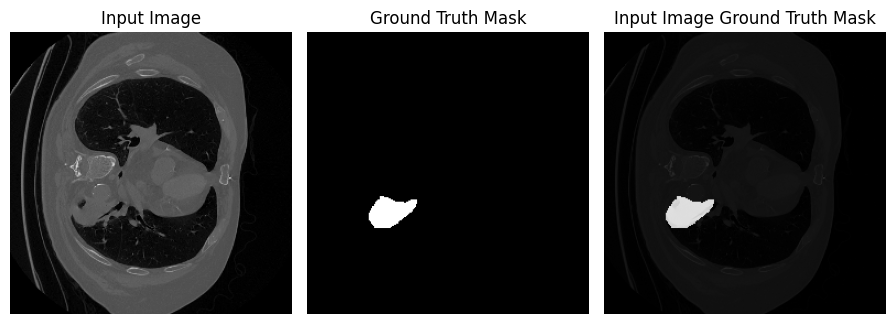

In [13]:

train_images_dir = '/kaggle/working/train/images'
train_masks_dir = '/kaggle/working/train/masks'

val_images_dir = '/kaggle/working/val/images'
val_masks_dir = '/kaggle/working/val/masks'

transform = transforms.Compose([
    transforms.Resize((image_size, image_size)),# Resize both images and masks
    transforms.ToTensor(),         # Convert to PyTorch tensor
])

train_dataset = SegmentationDataset(train_images_dir, train_masks_dir,transform)
val_dataset = SegmentationDataset(val_images_dir, val_masks_dir,transform)


print(f"Total samples in the train dataset: {len(train_dataset)}")
print(f"Total samples in the val dataset: {len(val_dataset)}")


train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=os.cpu_count(),pin_memory=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=True, num_workers=os.cpu_count(),pin_memory=True)

# Iterate through the DataLoader
for images, masks in train_loader:
    print(f"Batch image shape: {images.shape}, Batch mask shape: {masks.shape}")
    visualize(images[2],masks[2])
    break


# for idx in range(len(train_dataset)):
#     # Get image and mask paths
#     image_path = train_dataset.image_paths[idx]
#     mask_path = train_dataset.mask_paths[idx]
    
#     print("--------------------------------------------------")
#     print(f"Index: {idx}")
#     print(f"Image path: {image_path}")
#     print(f"Mask path: {mask_path}")
#     print("--------------------------------------------------")


## **Model Building**

In [14]:
class TwoConv(nn.Module):
    def __init__(self,in_channels,out_channels):
        super(TwoConv, self).__init__()
        self.conv1 = nn.Conv2d(in_channels,out_channels,kernel_size=3,padding='same',bias=True)
        self.dropout1 = nn.Dropout2d(0.2)
        self.batch_norm1 = nn.BatchNorm2d(out_channels)
        self.relu1 = nn.GELU()
        self.conv2 = nn.Conv2d(out_channels,out_channels,kernel_size=3,padding='same',bias=True)
        self.dropout2 = nn.Dropout2d(0.2)
        self.batch_norm2 = nn.BatchNorm2d(out_channels)
        self.relu2 = nn.GELU()

    def forward(self,x):
        x=self.conv1(x)
        x=self.dropout1(x)
        x=self.batch_norm1(x)
        x=self.relu1(x)
        x=self.conv2(x)
        x=self.dropout2(x)
        x=self.batch_norm2(x)
        x=self.relu2(x)
        return x

In [15]:
class DownBlock(nn.Module):
    def __init__(self,in_channels,out_channels):
        super(DownBlock, self).__init__()
        self.two_conv = TwoConv(in_channels,out_channels)
        self.down_sample = nn.MaxPool2d(kernel_size=2,stride=2)

    def forward(self,x):
        skip_connection = self.two_conv(x)
        down_out = self.down_sample(skip_connection)
        return (down_out,skip_connection)
    

In [16]:
class UpBlock(nn.Module):
    def __init__(self,in_channels,out_channels):
        super(UpBlock, self).__init__()
        self.up_conv = nn.ConvTranspose2d(in_channels,out_channels,kernel_size=2,stride=2,bias=True)
        self.batch_norm = nn.BatchNorm2d(out_channels*2)
        self.two_conv = TwoConv(in_channels,out_channels)

    def forward(self,x,skip_connection):
        x = self.up_conv(x)
        x = torch.cat([x, skip_connection], dim=1)
        x = self.batch_norm(x)
        return self.two_conv(x)

In [17]:
class UNet(nn.Module):
    def __init__(self,out_classes=1):
        super(UNet, self).__init__()
        # Encoder
        self.down1=DownBlock(1,32) # out 128
        self.down2=DownBlock(32,64) # out 64
        self.down3=DownBlock(64,128) # out 32
        self.down4=DownBlock(128,256) # out 16
        self.down5=DownBlock(256,512) # out 8
        
        # BottleNeck
        self.two_conv = TwoConv(512,1024) # out 4
        # Decoder
        self.up5 = UpBlock(1024,512) # out 16
        self.up4 = UpBlock(512,256) # out 32
        self.up3 = UpBlock(256,128) # out 64
        self.up2 = UpBlock(128,64) # out 128
        self.up1 = UpBlock(64,32) # out 256
        
        # Output
        self.last_conv = nn.Conv2d(32,out_classes,kernel_size=1)
        
        self.apply(self._init_weights)
        
    def forward(self,img):
        x,skip1 = self.down1(img)
        x,skip2 = self.down2(x)
        x,skip3 = self.down3(x)
        x,skip4 = self.down4(x)
        x,skip5 = self.down5(x)
        
        x = self.two_conv(x)
        
        x = self.up5(x,skip5)
        x = self.up4(x,skip4)
        x = self.up3(x,skip3)
        x = self.up2(x,skip2)
        x = self.up1(x,skip1)

        return self.last_conv(x)
        
    def _init_weights(self,module):
        if isinstance(module,nn.Conv2d):
            nn.init.kaiming_normal_(module.weight, nonlinearity='relu')
        

In [18]:
!pip install torchinfo torchviz

In [19]:
from torchinfo import summary

model = UNet(out_classes=1)
summary(model, input_size=(1, 1, 256, 256))  # Batch size, channels, height, and width

Layer (type:depth-idx)                   Output Shape              Param #
UNet                                     [1, 1, 256, 256]          --
├─DownBlock: 1-1                         [1, 32, 128, 128]         --
│    └─TwoConv: 2-1                      [1, 32, 256, 256]         --
│    │    └─Conv2d: 3-1                  [1, 32, 256, 256]         320
│    │    └─Dropout2d: 3-2               [1, 32, 256, 256]         --
│    │    └─BatchNorm2d: 3-3             [1, 32, 256, 256]         64
│    │    └─GELU: 3-4                    [1, 32, 256, 256]         --
│    │    └─Conv2d: 3-5                  [1, 32, 256, 256]         9,248
│    │    └─Dropout2d: 3-6               [1, 32, 256, 256]         --
│    │    └─BatchNorm2d: 3-7             [1, 32, 256, 256]         64
│    │    └─GELU: 3-8                    [1, 32, 256, 256]         --
│    └─MaxPool2d: 2-2                    [1, 32, 128, 128]         --
├─DownBlock: 1-2                         [1, 64, 64, 64]           --
│    └─TwoC

In [20]:
from torchviz import make_dot

model = UNet(out_classes=1)
x = torch.randn(1, 1, 256, 256)  # Example input
output = model(x)
# Create and save the visualization
dot = make_dot(output, params=dict(model.named_parameters()))
dot.render("unet_model", format="png")

'unet_model.png'

## **Training**

In [21]:
class BCEDiceLoss(nn.Module):
    def __init__(self,epsilon=1e-6,prob_of_bce = 0.4):
        super(BCEDiceLoss,self).__init__()
        self.epsilon = epsilon
        self.bce = nn.BCEWithLogitsLoss()
        self.prob_of_bce=prob_of_bce
        
    def forward(self,y_pred,y_true):
        # # binary crossentropy loss from logits
        bce_loss = self.bce(y_pred,y_true)

        # sigmoid for diceloss
        y_pred = y_pred.squeeze(1)
        y_pred = torch.sigmoid(y_pred)
        
        y_true = y_true.squeeze(1)
        # Flatten
        y_pred = y_pred.view(-1)
        y_true = y_true.view(-1)
        
        # Compute Dice Loss
        intersection = (y_pred * y_true).sum()
        union = y_pred.sum() + y_true.sum()
        dice = (2. * intersection + self.epsilon) / (union + self.epsilon)
        dice_loss = 1 - dice

        # Combine Dice and BCE losses
        return (self.prob_of_bce * bce_loss) + dice_loss

In [22]:
def dice_coefficient(pred, true, epsilon=1e-07):
    pred = pred.squeeze(1)
    true = true.squeeze(1)
    pred = (torch.sigmoid(pred) > 0.5).float()
    pred = pred.view(-1)
    true = true.view(-1).float()

    intersection = abs(torch.sum(pred * true))
    union = abs(torch.sum(pred) + torch.sum(true))
    dice = (2. * intersection + epsilon) / (union + epsilon)
    
    return dice

In [23]:
def pixel_accuracy_binary(pred, true):

    pred = pred.squeeze(1)
    true = true.squeeze(1)
    pred = (torch.sigmoid(pred) > 0.5).float()
    pred = pred.view(-1)
    true = true.view(-1).float()

    # Calculate pixel-wise accuracy
    correct = (pred == true).sum().item()
    total = true.numel()

    return correct / total


In [24]:
def calculate_iou(pred,true):
    pred = pred.squeeze(1)
    true = true.squeeze(1)
    pred = (torch.sigmoid(pred) > 0.5).float()
    pred = pred.view(-1)
    true = true.view(-1).float()
    
    intersection = torch.sum(pred * true)
    union = torch.sum(pred) + torch.sum(true) - intersection
    
    iou = intersection / (union + 1e-6)  # Add a small epsilon to avoid division by zero
    return iou

In [25]:
def validate(model,loss_fn,val_loader,device,num_samples=2):
    model.eval()
    val_loss=0
    iou=0
    acc=0
    dice = 0
    with torch.no_grad():
        for img,mask in val_loader:
            img,mask = img.to(device),mask.to(device)
            pred = model(img)
            loss = loss_fn(pred,mask)
            
            val_loss += loss.item()
            iou += calculate_iou(pred,mask).item()
            dice += dice_coefficient(pred,mask).item()
            acc+=pixel_accuracy_binary(pred,mask)
        for img,mask in val_loader:
            img,mask = img.to(device),mask.to(device)
            for i in range(num_samples):
                input = img[i]
                input= input.unsqueeze(0)
                pred = model(input)
                pred = pred.squeeze(0)
                pred = torch.sigmoid(pred)
                pred = (pred > 0.5).float()
                visualize(img[i],mask[i],pred)
            break
    val_loss/=len(val_loader)
    iou/=len(val_loader)
    dice/=len(val_loader)
    acc/=len(val_loader)
    return val_loss,iou,dice,acc

In [26]:
# !pip install -q -U segmentation-models-pytorch albumentations > /dev/null
# import segmentation_models_pytorch as smp

In [27]:
EPOCHS = 100
lr=0.01
prob_of_bce=0.4
weight_decay = 0.0001
model = UNet(1)
model.to(device)
optimizer = torch.optim.AdamW(model.parameters(),lr=lr,fused=True,weight_decay=weight_decay)
# loss_fn = smp.losses.DiceLoss(mode='binary')
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='max',factor=0.1, patience=20)
loss_fn = BCEDiceLoss(prob_of_bce=prob_of_bce)

In [28]:
model_dir = 'model'
log_dir = 'log'
os.makedirs(log_dir,exist_ok=True)
os.makedirs(model_dir, exist_ok=True)
log_file = os.path.join(log_dir,f'log.txt')
with open(log_file,'w') as f:
    f.write(f"Epochs {EPOCHS} | learning_rate {lr} | weight_decay {weight_decay} | Dropout {0.2} | Prob Of BCE Loss {prob_of_bce}| optimizer {optimizer.__class__.__name__}| loss function {loss_fn.__class__.__name__}| Batch size {batch_size}| Image size {image_size}\n")

Epoch 1/100: 100%|██████████| 58/58 [00:22<00:00,  2.58it/s]


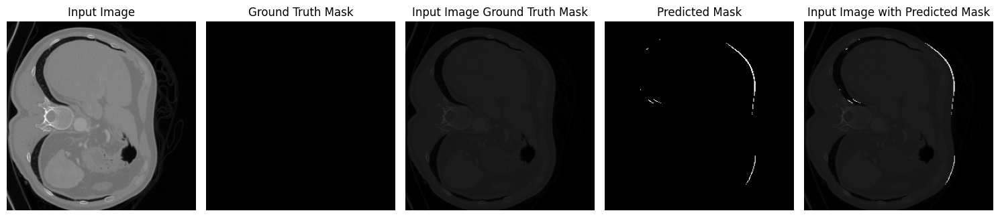

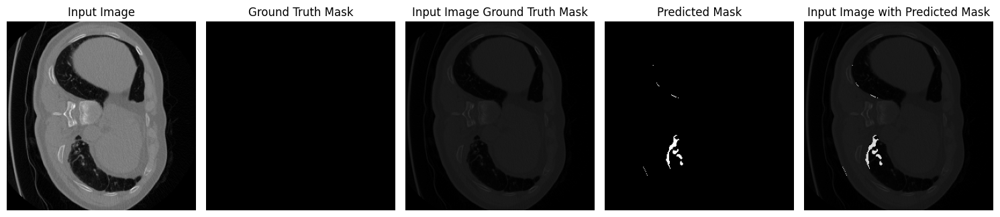

Achieved Better IOU with 0.0017879110237117857, Than 0
Epoch 1| Train_loss: 1.0314| Validate_loss: 1.0462| Val IOU: 0.0018| Val Best IOU 0.0018| Val Dice Coefficient 0.0036| lr 0.01| Accuracy 0.9198


Epoch 2/100: 100%|██████████| 58/58 [00:22<00:00,  2.63it/s]


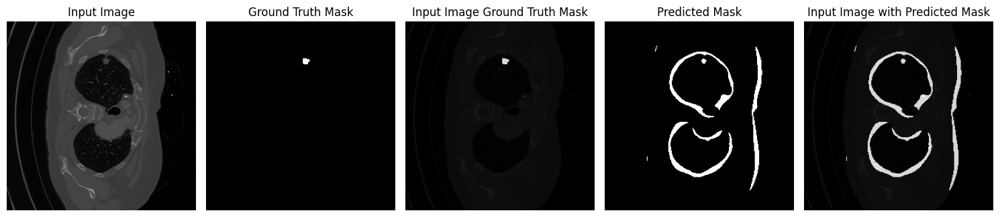

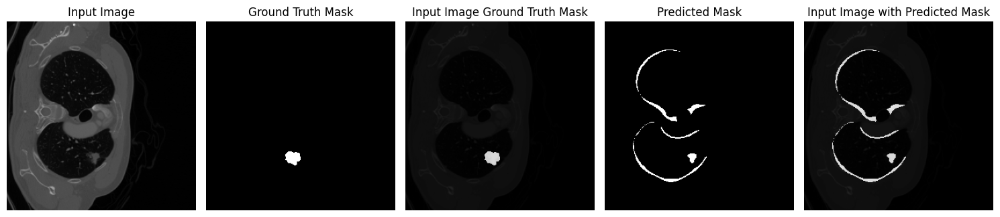

Achieved Better IOU with 0.0333386599086225, Than 0.0017879110237117857
Epoch 2| Train_loss: 0.9462| Validate_loss: 0.9696| Val IOU: 0.0333| Val Best IOU 0.0333| Val Dice Coefficient 0.0640| lr 0.01| Accuracy 0.9805


Epoch 3/100: 100%|██████████| 58/58 [00:22<00:00,  2.63it/s]


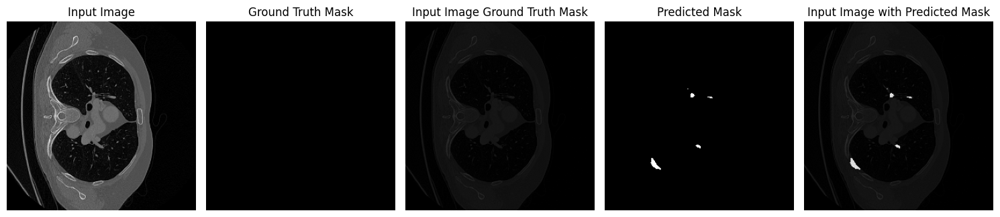

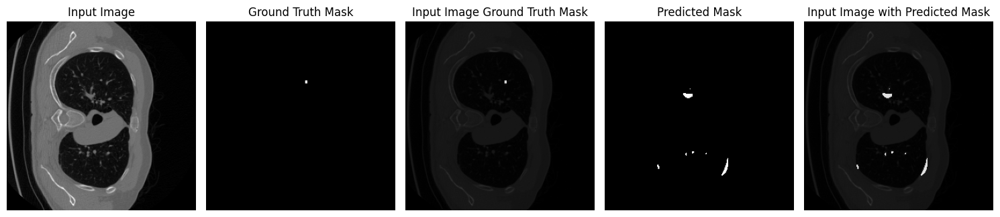

Epoch 3| Train_loss: 0.8246| Validate_loss: 0.9624| Val IOU: 0.0254| Val Best IOU 0.0333| Val Dice Coefficient 0.0494| lr 0.01| Accuracy 0.9948


Epoch 4/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


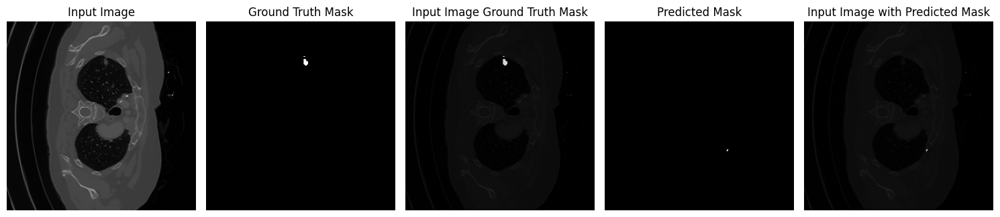

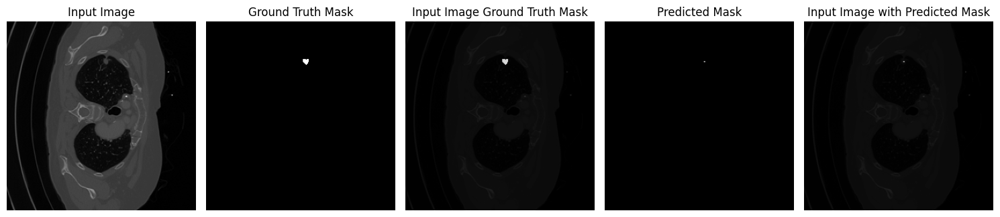

Epoch 4| Train_loss: 0.6481| Validate_loss: 0.9948| Val IOU: 0.0151| Val Best IOU 0.0333| Val Dice Coefficient 0.0293| lr 0.01| Accuracy 0.9936


Epoch 5/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


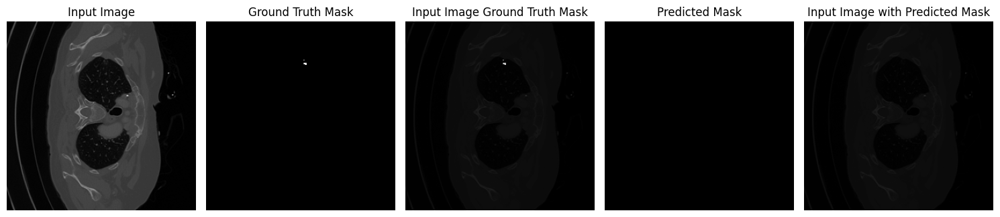

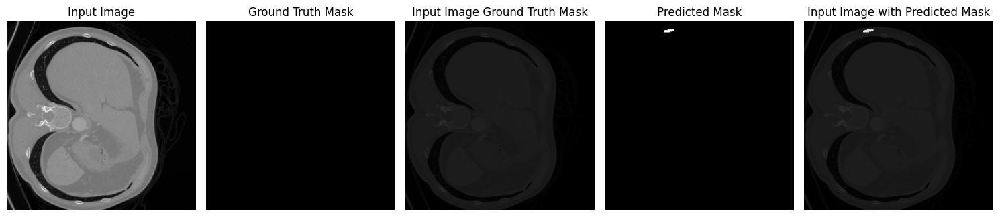

Achieved Better IOU with 0.16514990478754044, Than 0.0333386599086225
Epoch 5| Train_loss: 0.5114| Validate_loss: 0.7279| Val IOU: 0.1651| Val Best IOU 0.1651| Val Dice Coefficient 0.2787| lr 0.01| Accuracy 0.9983


Epoch 6/100: 100%|██████████| 58/58 [00:22<00:00,  2.63it/s]


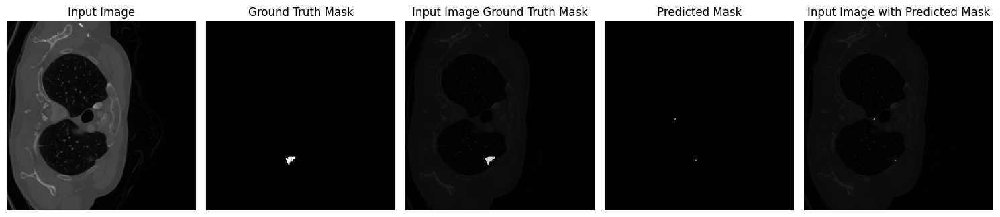

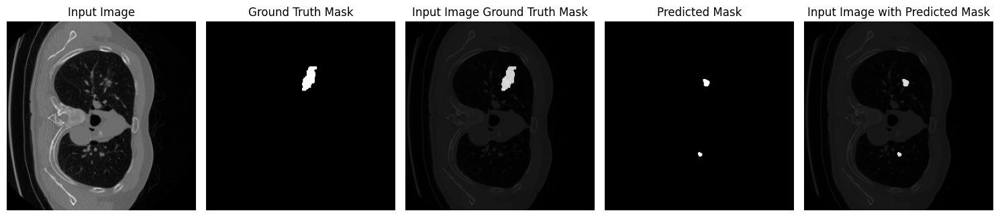

Epoch 6| Train_loss: 0.4377| Validate_loss: 0.7440| Val IOU: 0.1517| Val Best IOU 0.1651| Val Dice Coefficient 0.2613| lr 0.01| Accuracy 0.9983


Epoch 7/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


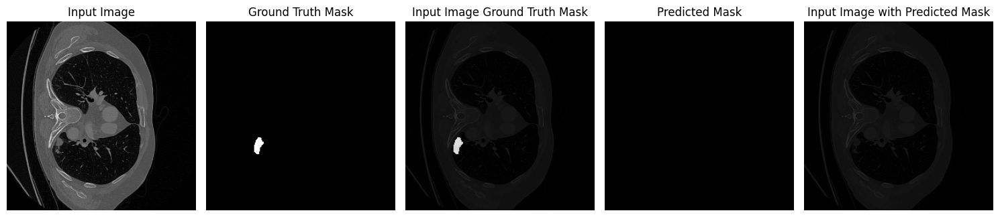

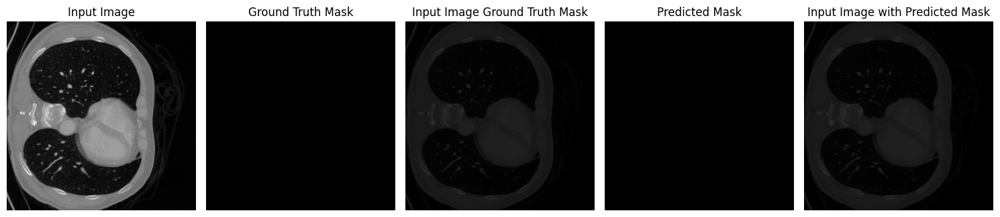

Epoch 7| Train_loss: 0.3750| Validate_loss: 0.8005| Val IOU: 0.1203| Val Best IOU 0.1651| Val Dice Coefficient 0.2060| lr 0.01| Accuracy 0.9986


Epoch 8/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


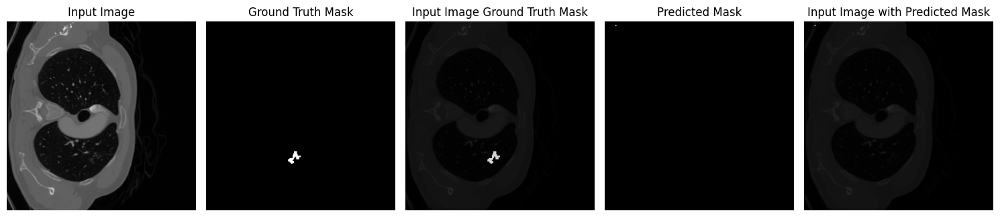

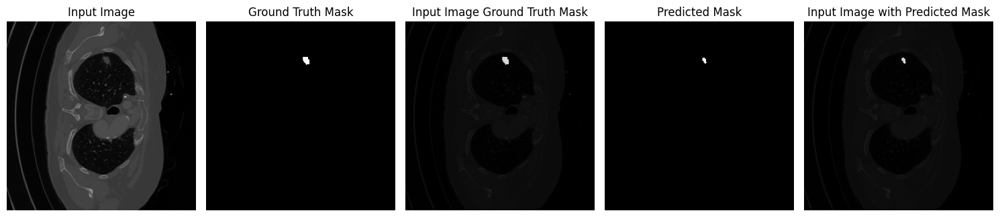

Epoch 8| Train_loss: 0.3423| Validate_loss: 0.7823| Val IOU: 0.1339| Val Best IOU 0.1651| Val Dice Coefficient 0.2238| lr 0.01| Accuracy 0.9988


Epoch 9/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


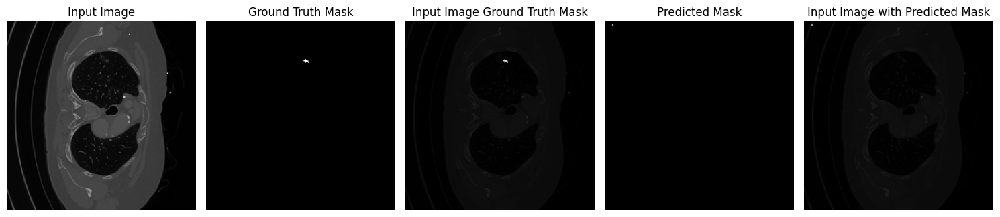

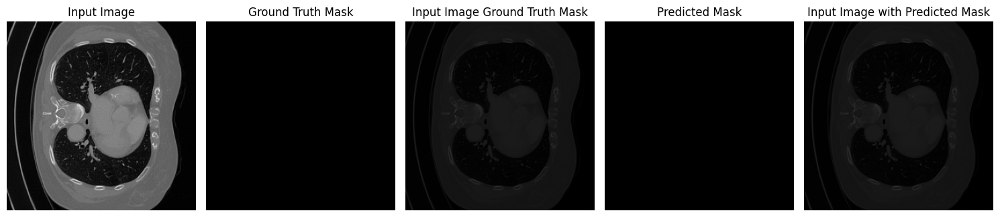

Achieved Better IOU with 0.20244427397847176, Than 0.16514990478754044
Epoch 9| Train_loss: 0.3373| Validate_loss: 0.6882| Val IOU: 0.2024| Val Best IOU 0.2024| Val Dice Coefficient 0.3177| lr 0.01| Accuracy 0.9989


Epoch 10/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


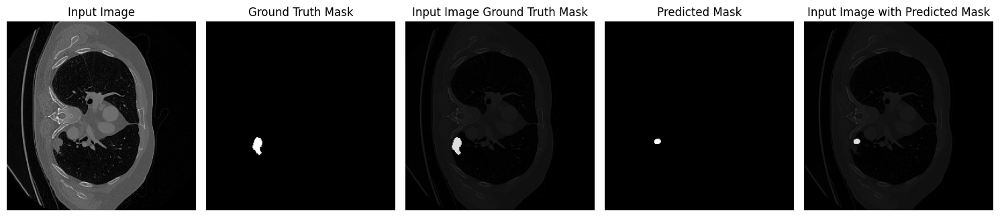

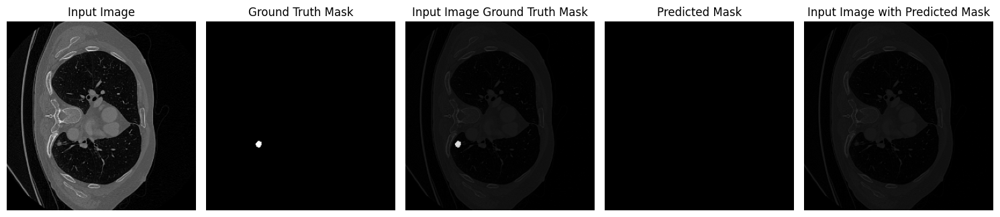

Achieved Better IOU with 0.2453000545501709, Than 0.20244427397847176
Epoch 10| Train_loss: 0.3215| Validate_loss: 0.6298| Val IOU: 0.2453| Val Best IOU 0.2453| Val Dice Coefficient 0.3804| lr 0.01| Accuracy 0.9981


Epoch 11/100: 100%|██████████| 58/58 [00:22<00:00,  2.64it/s]


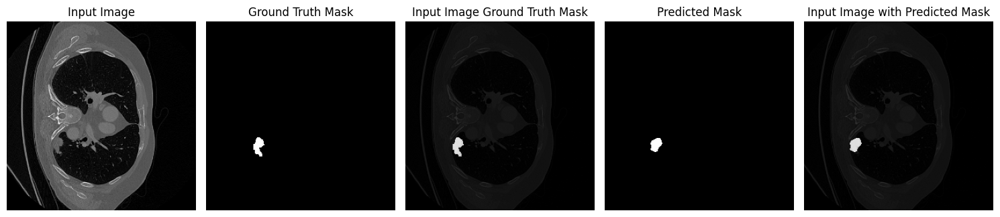

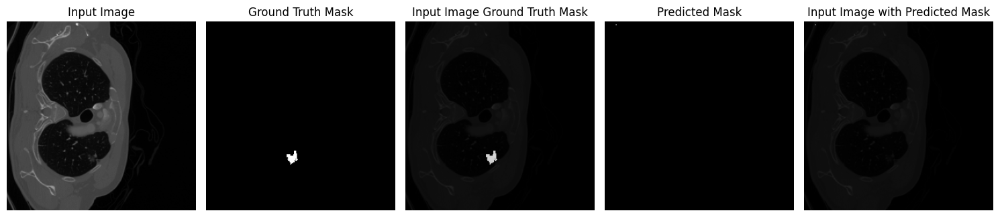

Achieved Better IOU with 0.26405058428645134, Than 0.2453000545501709
Epoch 11| Train_loss: 0.3061| Validate_loss: 0.5907| Val IOU: 0.2641| Val Best IOU 0.2641| Val Dice Coefficient 0.4168| lr 0.01| Accuracy 0.9986


Epoch 12/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


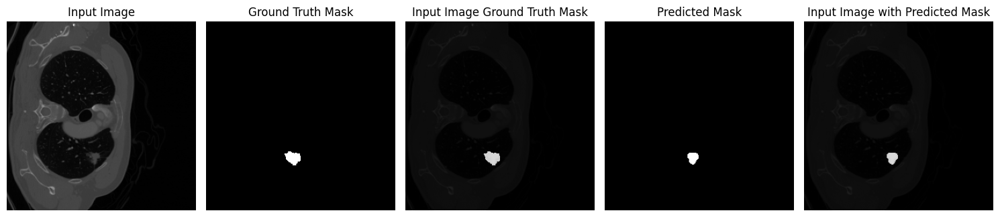

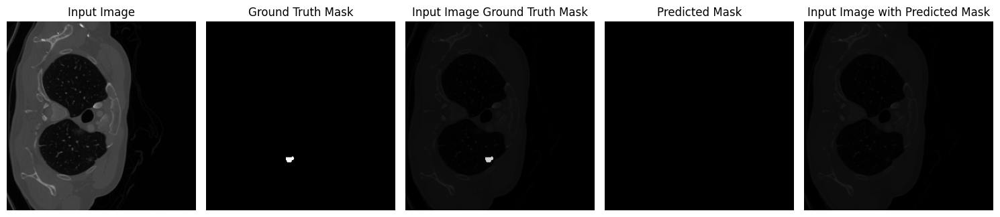

Achieved Better IOU with 0.46083901822566986, Than 0.26405058428645134
Epoch 12| Train_loss: 0.2825| Validate_loss: 0.3848| Val IOU: 0.4608| Val Best IOU 0.4608| Val Dice Coefficient 0.6186| lr 0.01| Accuracy 0.9990


Epoch 13/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


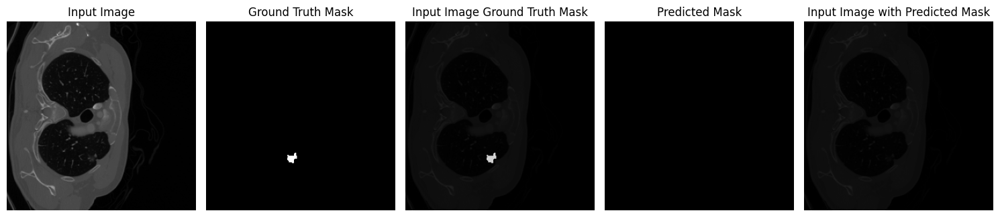

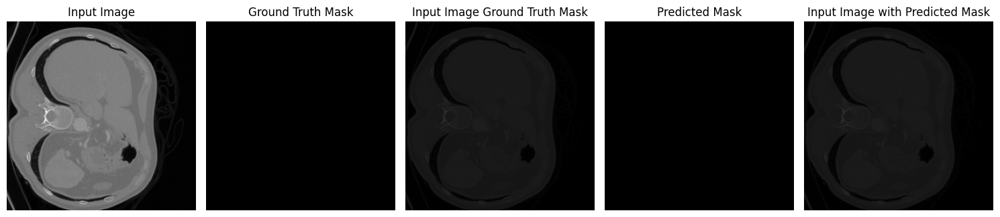

Epoch 13| Train_loss: 0.2706| Validate_loss: 0.5137| Val IOU: 0.3334| Val Best IOU 0.4608| Val Dice Coefficient 0.4943| lr 0.01| Accuracy 0.9987


Epoch 14/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


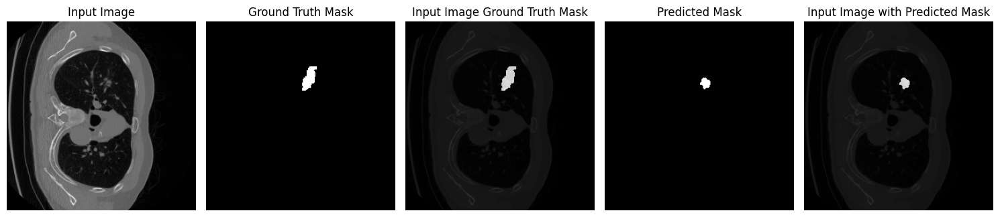

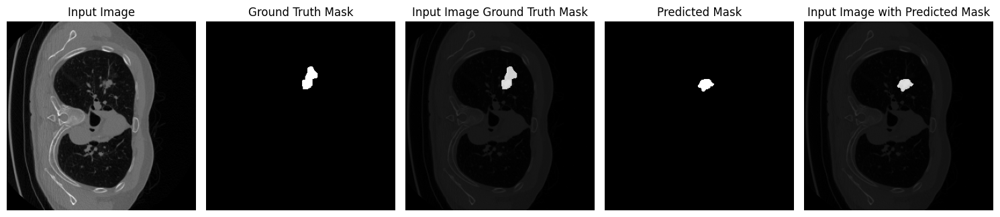

Epoch 14| Train_loss: 0.2623| Validate_loss: 0.4321| Val IOU: 0.4050| Val Best IOU 0.4608| Val Dice Coefficient 0.5751| lr 0.01| Accuracy 0.9986


Epoch 15/100: 100%|██████████| 58/58 [00:22<00:00,  2.63it/s]


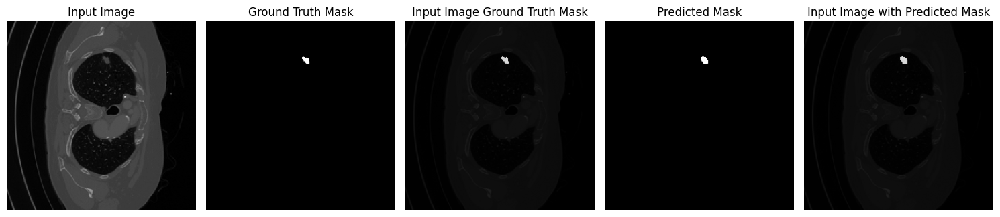

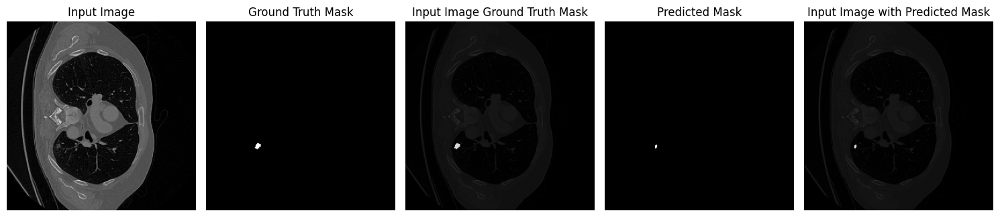

Achieved Better IOU with 0.46891986578702927, Than 0.46083901822566986
Epoch 15| Train_loss: 0.2320| Validate_loss: 0.3742| Val IOU: 0.4689| Val Best IOU 0.4689| Val Dice Coefficient 0.6328| lr 0.01| Accuracy 0.9990


Epoch 16/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


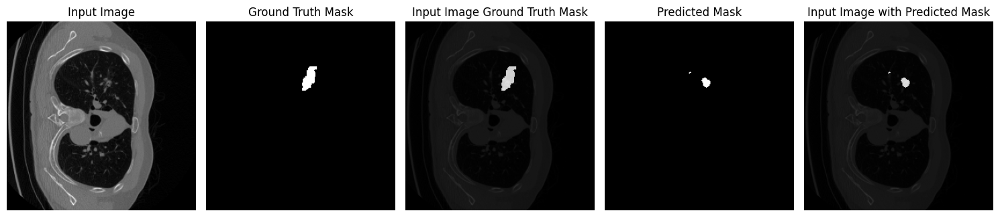

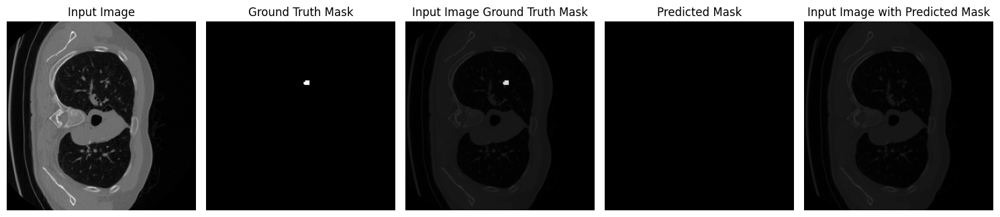

Epoch 16| Train_loss: 0.2377| Validate_loss: 0.4278| Val IOU: 0.4088| Val Best IOU 0.4689| Val Dice Coefficient 0.5785| lr 0.01| Accuracy 0.9989


Epoch 17/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


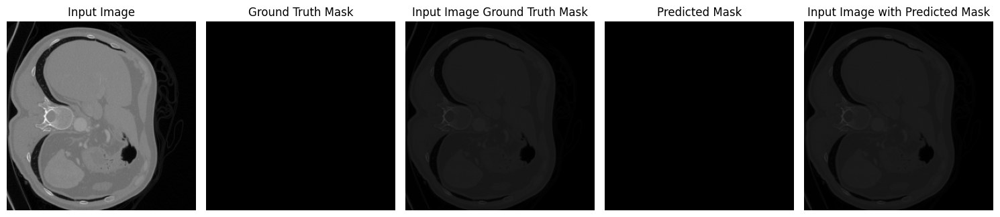

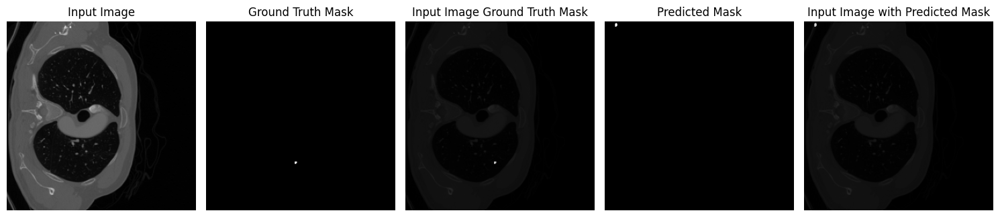

Epoch 17| Train_loss: 0.2257| Validate_loss: 0.3995| Val IOU: 0.4388| Val Best IOU 0.4689| Val Dice Coefficient 0.6078| lr 0.01| Accuracy 0.9990


Epoch 18/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


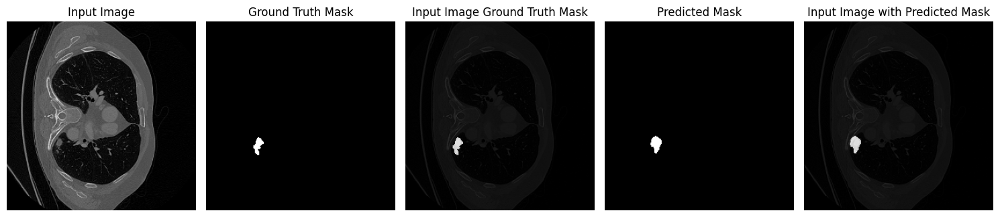

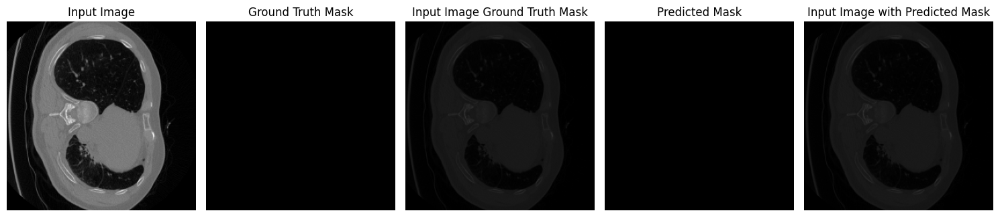

Epoch 18| Train_loss: 0.2084| Validate_loss: 0.5333| Val IOU: 0.3426| Val Best IOU 0.4689| Val Dice Coefficient 0.7202| lr 0.01| Accuracy 0.9992


Epoch 19/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


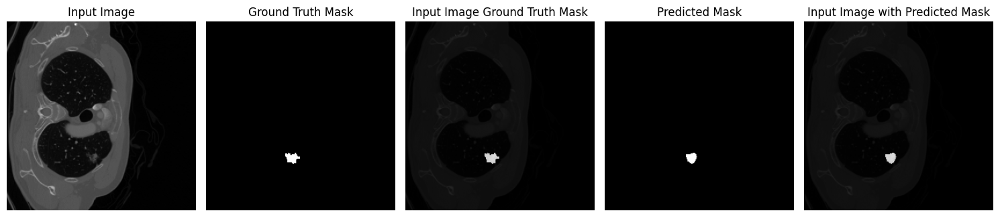

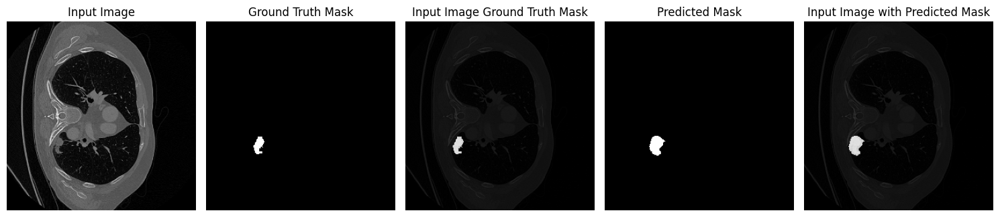

Achieved Better IOU with 0.5533811002969742, Than 0.46891986578702927
Epoch 19| Train_loss: 0.1998| Validate_loss: 0.2974| Val IOU: 0.5534| Val Best IOU 0.5534| Val Dice Coefficient 0.7081| lr 0.01| Accuracy 0.9991


Epoch 20/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


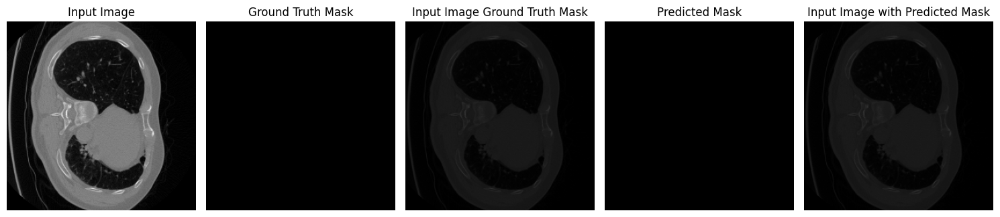

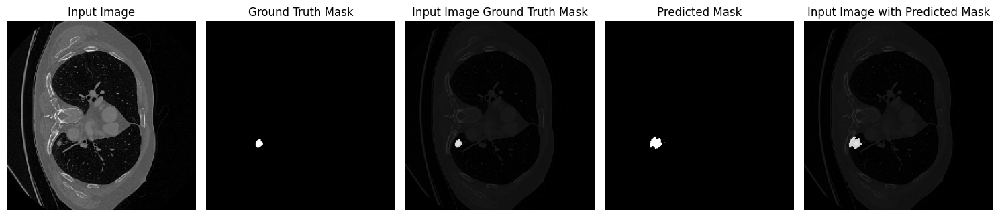

Epoch 20| Train_loss: 0.1959| Validate_loss: 0.4109| Val IOU: 0.4275| Val Best IOU 0.5534| Val Dice Coefficient 0.5971| lr 0.01| Accuracy 0.9989


Epoch 21/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


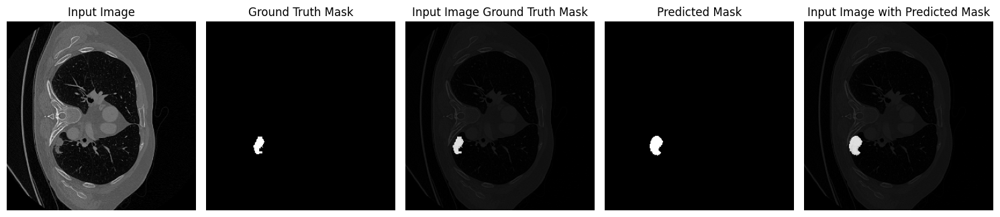

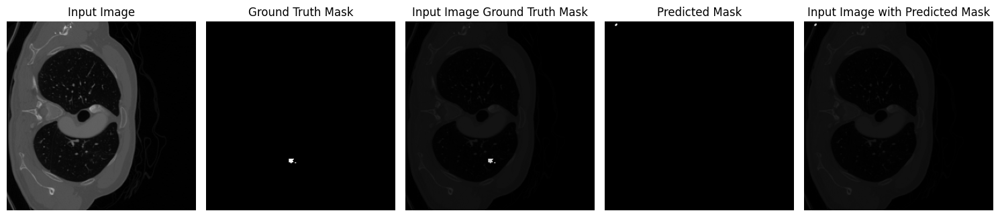

Epoch 21| Train_loss: 0.1849| Validate_loss: 0.5492| Val IOU: 0.3287| Val Best IOU 0.5534| Val Dice Coefficient 0.4568| lr 0.01| Accuracy 0.9991


Epoch 22/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


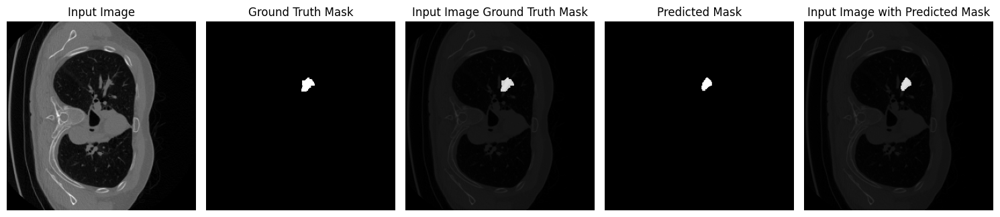

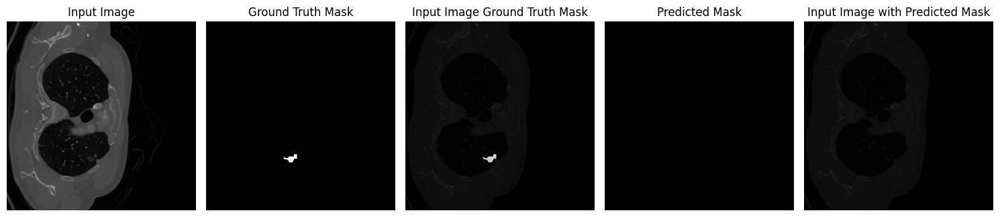

Epoch 22| Train_loss: 0.1860| Validate_loss: 0.3265| Val IOU: 0.5123| Val Best IOU 0.5534| Val Dice Coefficient 0.6772| lr 0.01| Accuracy 0.9992


Epoch 23/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


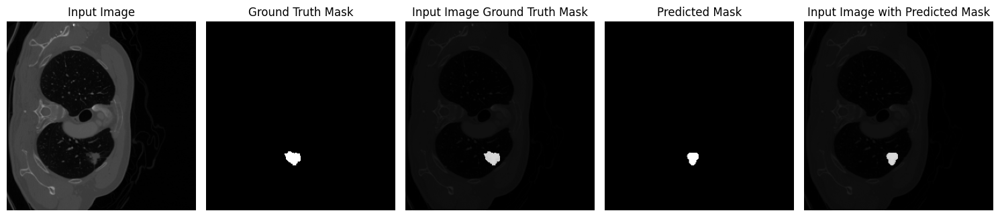

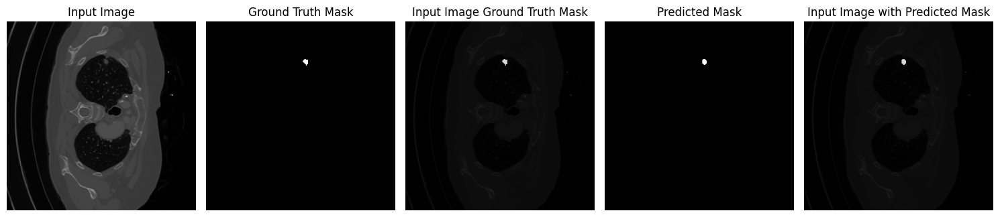

Epoch 23| Train_loss: 0.1755| Validate_loss: 0.3259| Val IOU: 0.5242| Val Best IOU 0.5534| Val Dice Coefficient 0.6797| lr 0.01| Accuracy 0.9990


Epoch 24/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


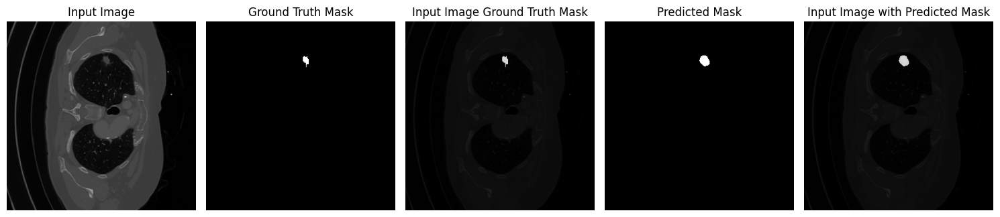

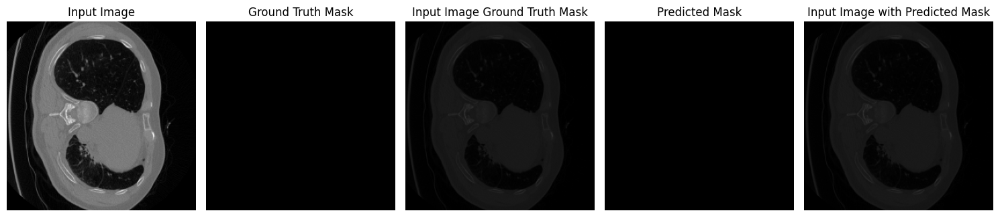

Achieved Better IOU with 0.5638850703835487, Than 0.5533811002969742
Epoch 24| Train_loss: 0.1730| Validate_loss: 0.2839| Val IOU: 0.5639| Val Best IOU 0.5639| Val Dice Coefficient 0.7198| lr 0.01| Accuracy 0.9991


Epoch 25/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


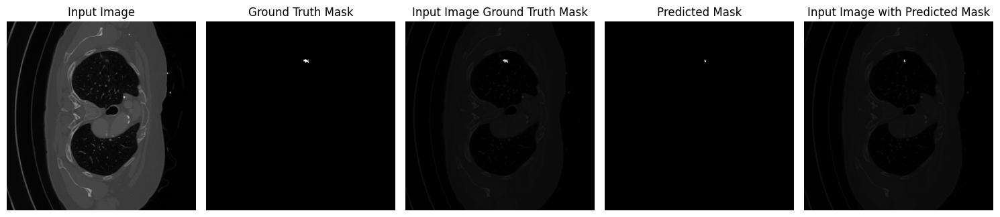

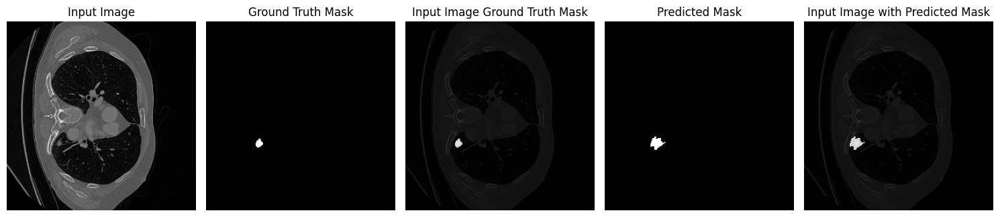

Epoch 25| Train_loss: 0.1685| Validate_loss: 0.2944| Val IOU: 0.5552| Val Best IOU 0.5639| Val Dice Coefficient 0.7111| lr 0.01| Accuracy 0.9990


Epoch 26/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


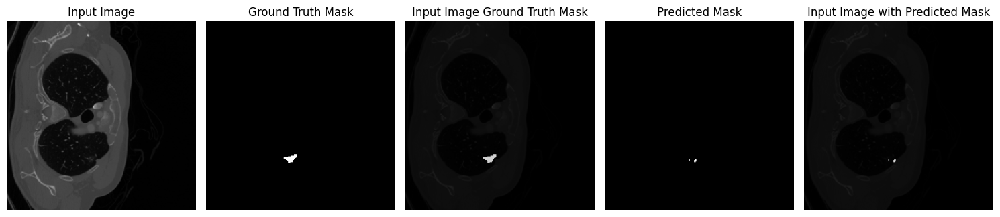

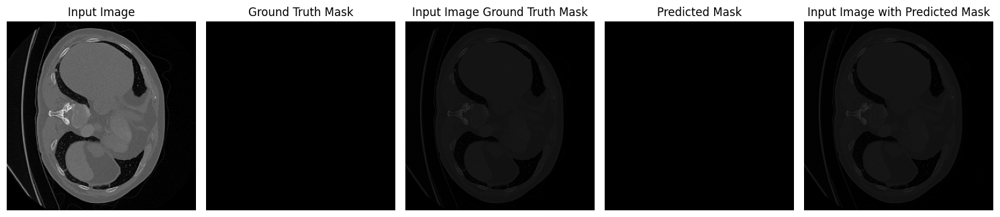

Achieved Better IOU with 0.5813790112733841, Than 0.5638850703835487
Epoch 26| Train_loss: 0.1664| Validate_loss: 0.2690| Val IOU: 0.5814| Val Best IOU 0.5814| Val Dice Coefficient 0.7338| lr 0.01| Accuracy 0.9992


Epoch 27/100: 100%|██████████| 58/58 [00:22<00:00,  2.64it/s]


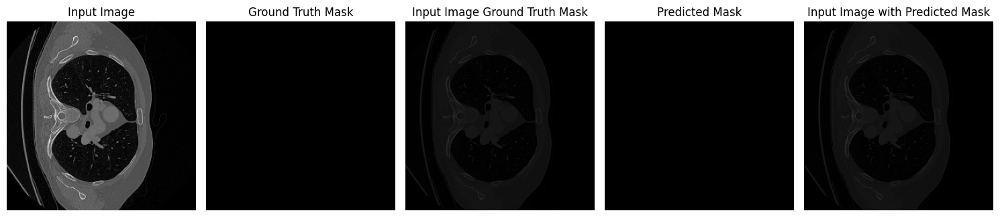

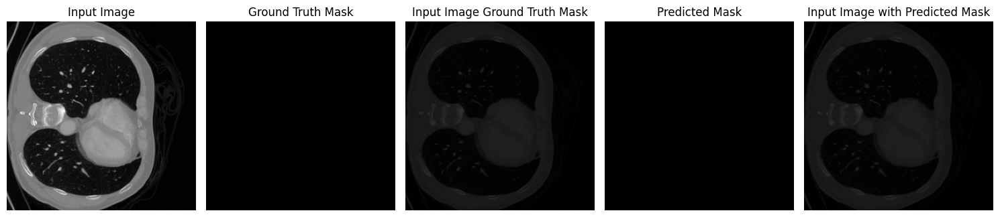

Achieved Better IOU with 0.5909661948680878, Than 0.5813790112733841
Epoch 27| Train_loss: 0.1649| Validate_loss: 0.2652| Val IOU: 0.5910| Val Best IOU 0.5910| Val Dice Coefficient 0.7384| lr 0.01| Accuracy 0.9992


Epoch 28/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


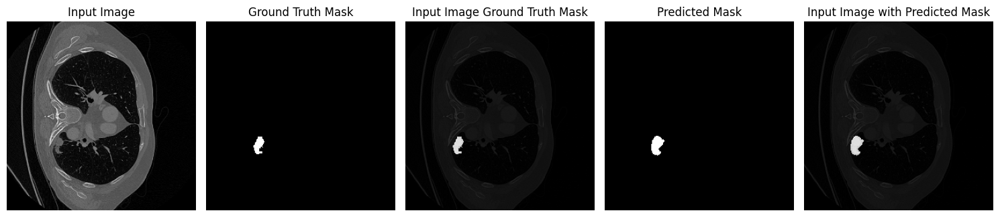

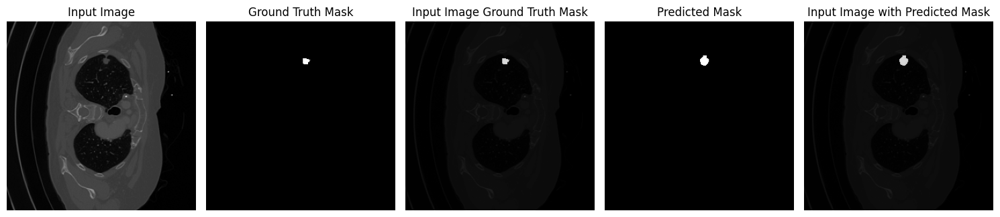

Epoch 28| Train_loss: 0.1633| Validate_loss: 0.3607| Val IOU: 0.4794| Val Best IOU 0.5910| Val Dice Coefficient 0.6471| lr 0.01| Accuracy 0.9986


Epoch 29/100: 100%|██████████| 58/58 [00:22<00:00,  2.64it/s]


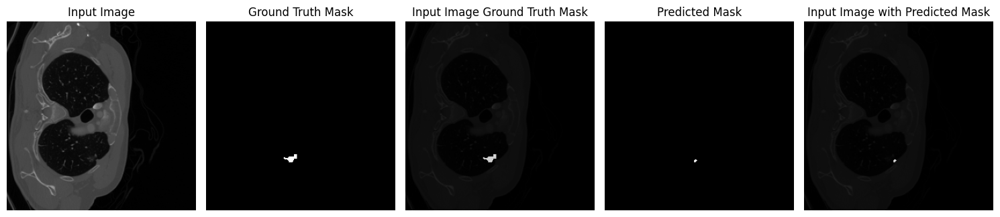

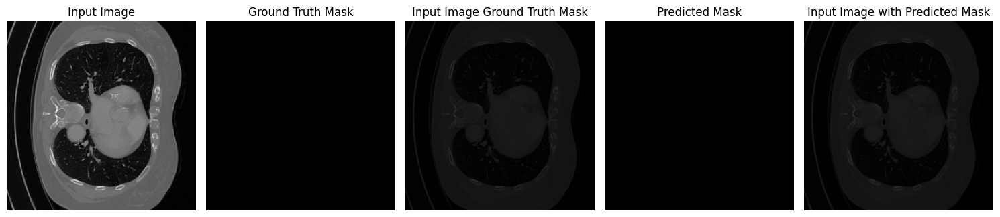

Epoch 29| Train_loss: 0.1557| Validate_loss: 0.3585| Val IOU: 0.4810| Val Best IOU 0.5910| Val Dice Coefficient 0.6479| lr 0.01| Accuracy 0.9986


Epoch 30/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


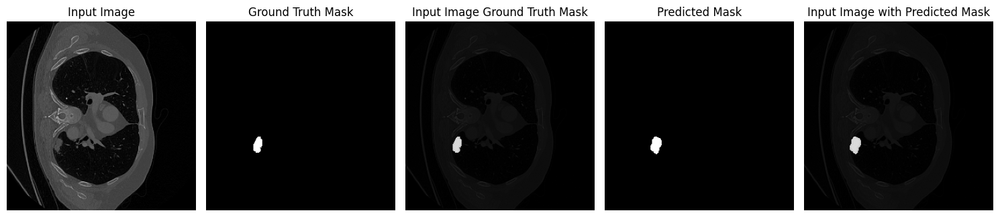

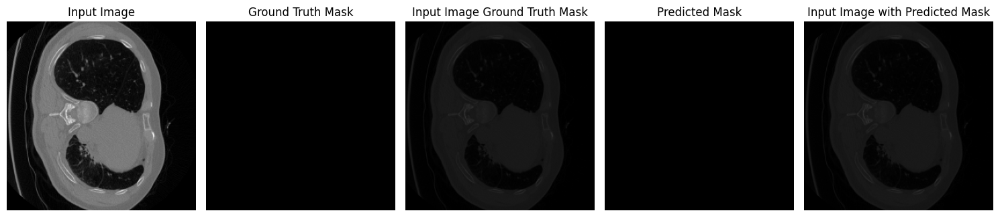

Epoch 30| Train_loss: 0.1489| Validate_loss: 0.2857| Val IOU: 0.5678| Val Best IOU 0.5910| Val Dice Coefficient 0.7184| lr 0.01| Accuracy 0.9992


Epoch 31/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


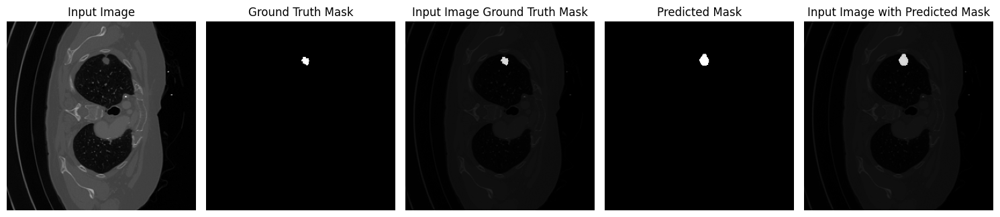

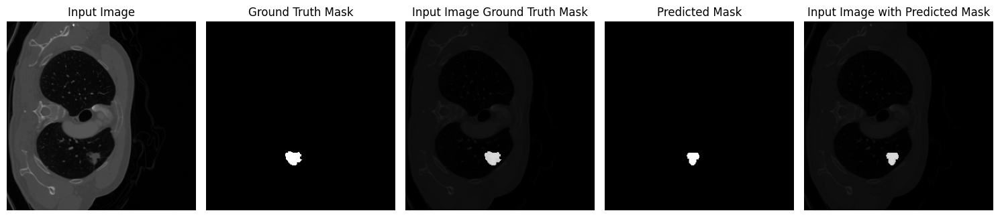

Epoch 31| Train_loss: 0.1467| Validate_loss: 0.3129| Val IOU: 0.5274| Val Best IOU 0.5910| Val Dice Coefficient 0.6900| lr 0.01| Accuracy 0.9991


Epoch 32/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


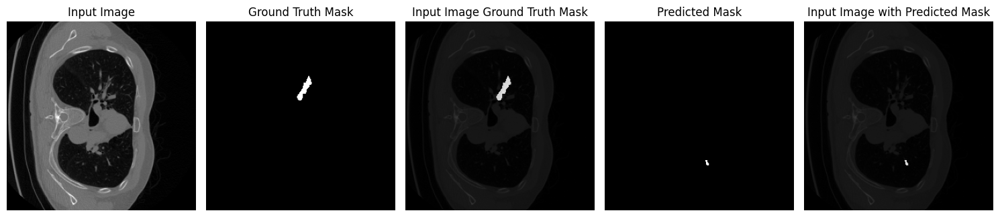

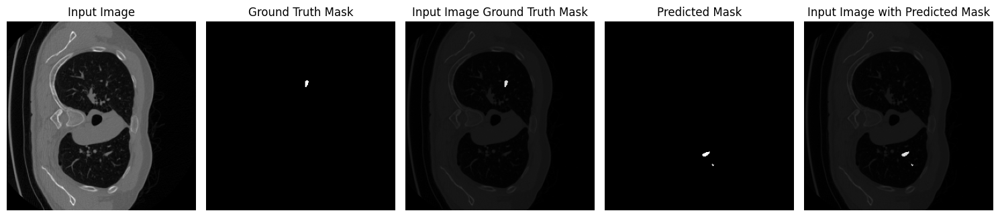

Epoch 32| Train_loss: 0.1462| Validate_loss: 0.4879| Val IOU: 0.3935| Val Best IOU 0.5910| Val Dice Coefficient 0.5159| lr 0.01| Accuracy 0.9990


Epoch 33/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


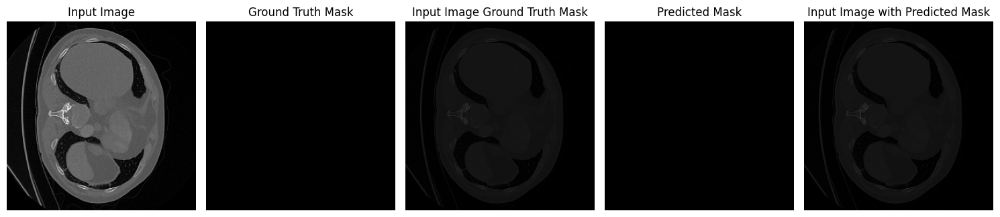

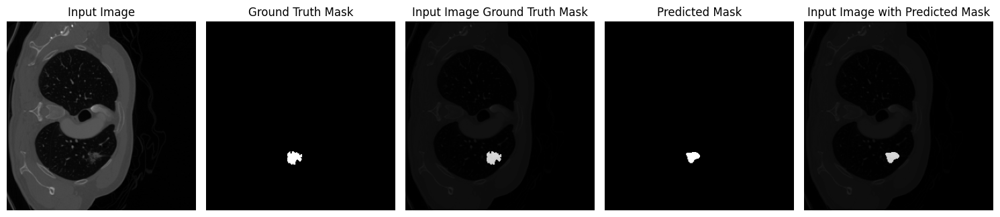

Epoch 33| Train_loss: 0.1598| Validate_loss: 0.3107| Val IOU: 0.5354| Val Best IOU 0.5910| Val Dice Coefficient 0.6944| lr 0.01| Accuracy 0.9990


Epoch 34/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


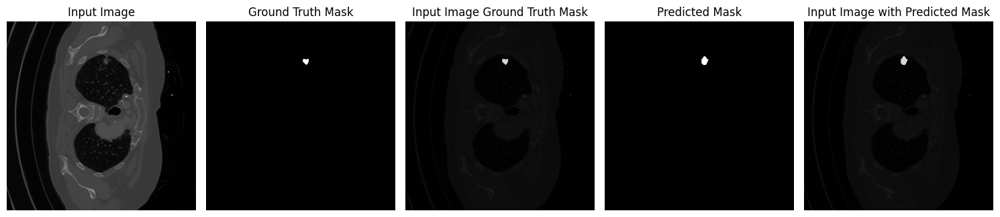

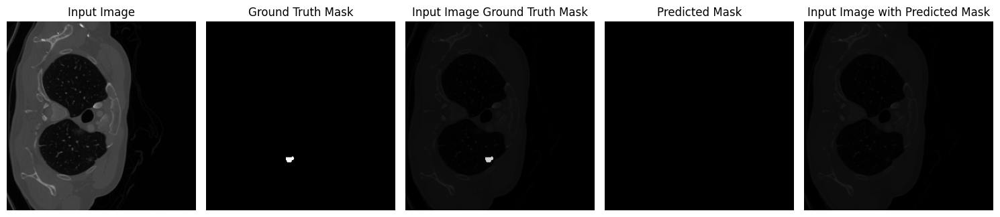

Epoch 34| Train_loss: 0.1750| Validate_loss: 0.3259| Val IOU: 0.5167| Val Best IOU 0.5910| Val Dice Coefficient 0.6810| lr 0.01| Accuracy 0.9990


Epoch 35/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


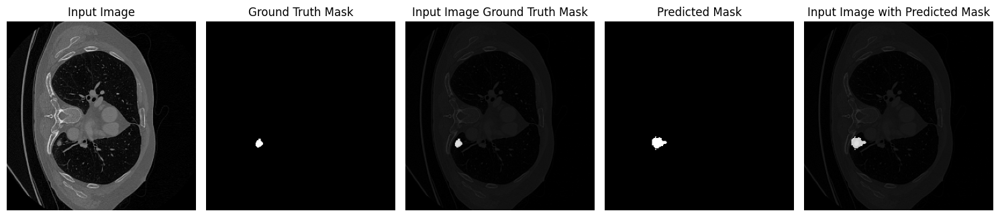

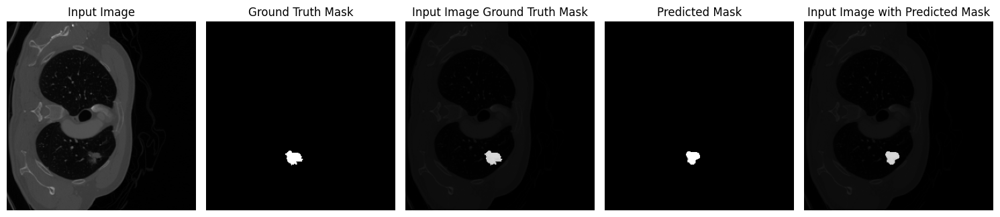

Epoch 35| Train_loss: 0.1448| Validate_loss: 0.2794| Val IOU: 0.5747| Val Best IOU 0.5910| Val Dice Coefficient 0.7270| lr 0.01| Accuracy 0.9990


Epoch 36/100: 100%|██████████| 58/58 [00:22<00:00,  2.64it/s]


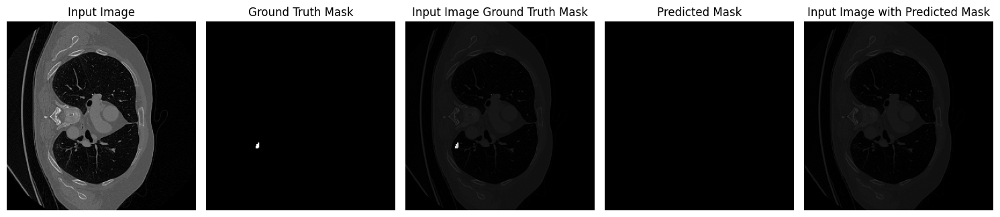

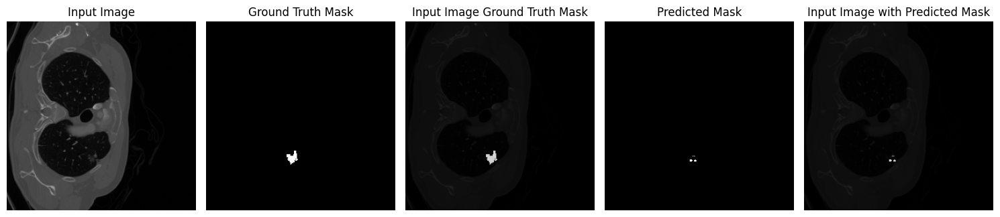

Epoch 36| Train_loss: 0.1503| Validate_loss: 0.3567| Val IOU: 0.4812| Val Best IOU 0.5910| Val Dice Coefficient 0.6480| lr 0.01| Accuracy 0.9990


Epoch 37/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


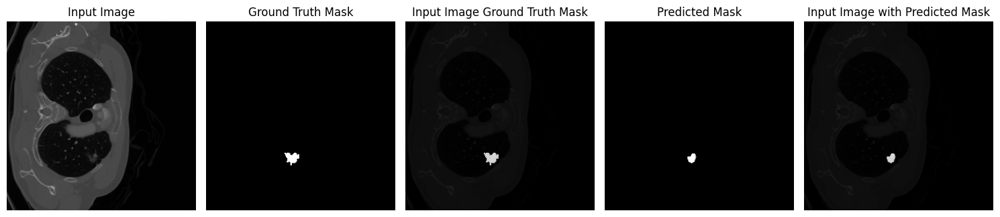

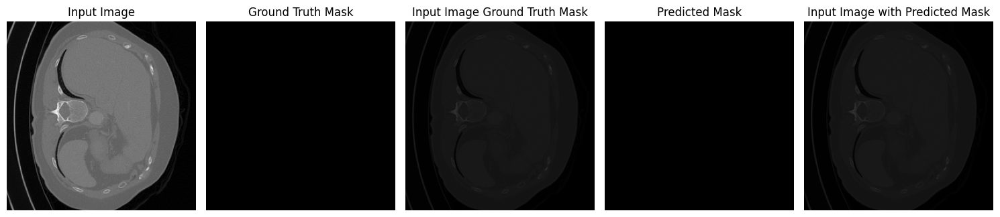

Epoch 37| Train_loss: 0.1395| Validate_loss: 0.4659| Val IOU: 0.4191| Val Best IOU 0.5910| Val Dice Coefficient 0.7873| lr 0.01| Accuracy 0.9994


Epoch 38/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


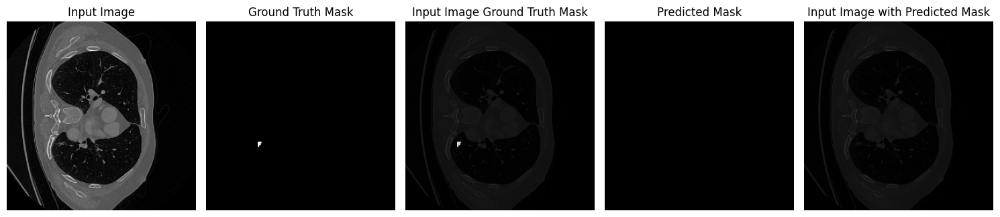

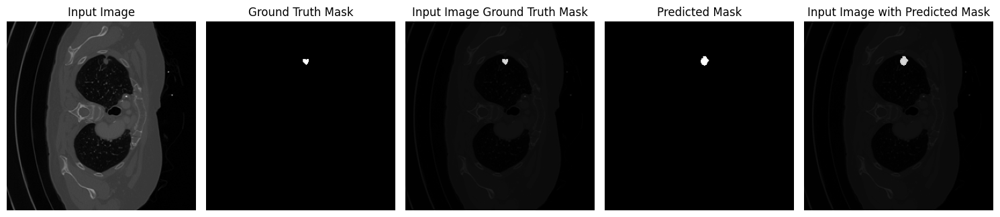

Epoch 38| Train_loss: 0.1455| Validate_loss: 0.4890| Val IOU: 0.3915| Val Best IOU 0.5910| Val Dice Coefficient 0.7642| lr 0.01| Accuracy 0.9993


Epoch 39/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


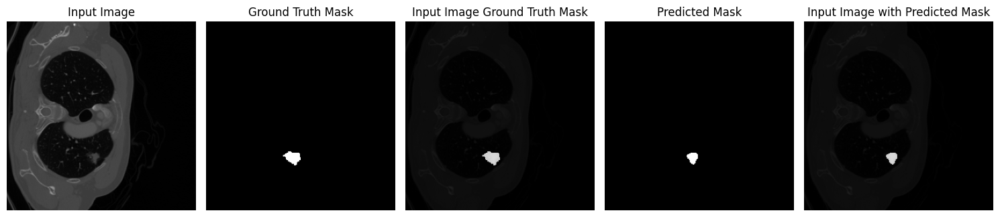

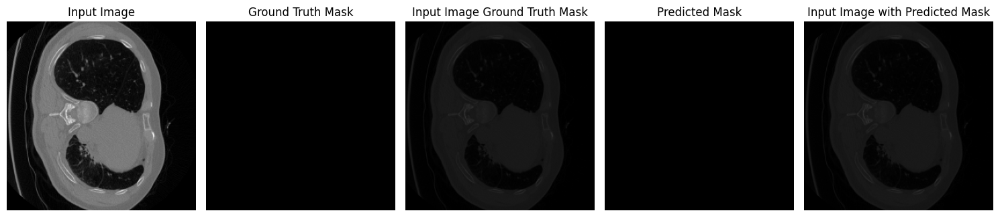

Epoch 39| Train_loss: 0.1578| Validate_loss: 0.5248| Val IOU: 0.3500| Val Best IOU 0.5910| Val Dice Coefficient 0.4767| lr 0.01| Accuracy 0.9992


Epoch 40/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


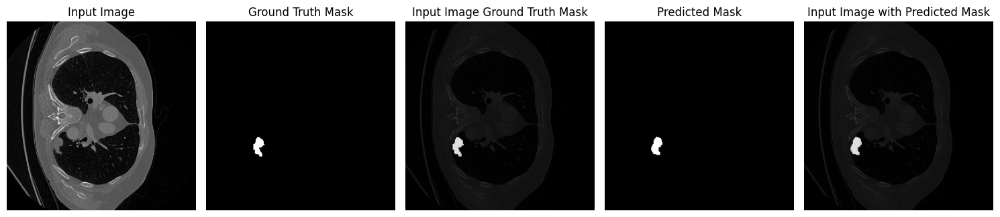

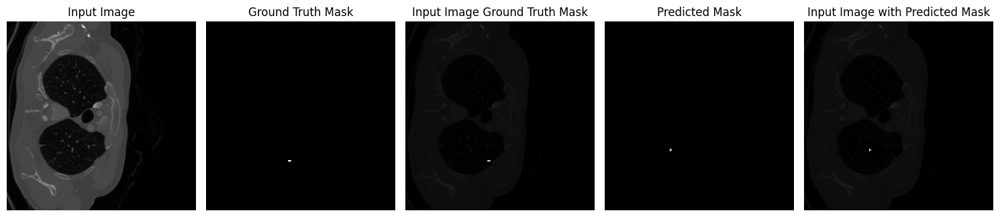

Epoch 40| Train_loss: 0.1423| Validate_loss: 0.3311| Val IOU: 0.5135| Val Best IOU 0.5910| Val Dice Coefficient 0.6731| lr 0.01| Accuracy 0.9991


Epoch 41/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


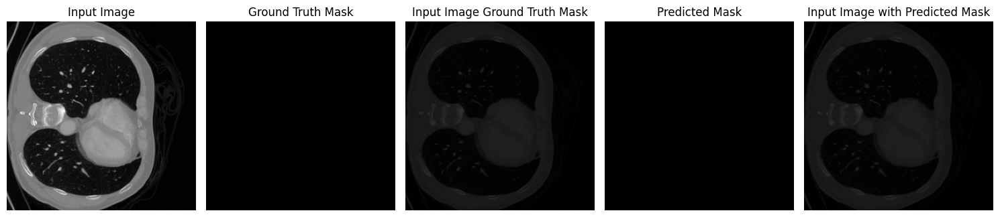

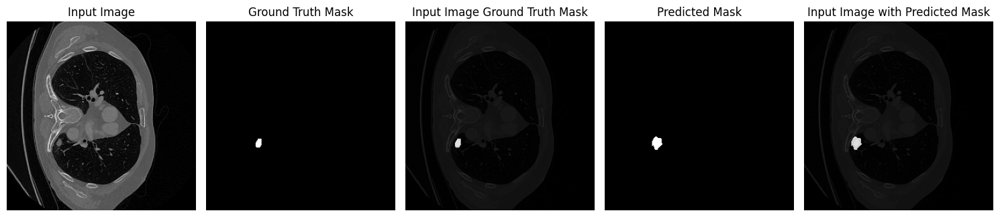

Epoch 41| Train_loss: 0.1295| Validate_loss: 0.4863| Val IOU: 0.3962| Val Best IOU 0.5910| Val Dice Coefficient 0.5185| lr 0.01| Accuracy 0.9990


Epoch 42/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


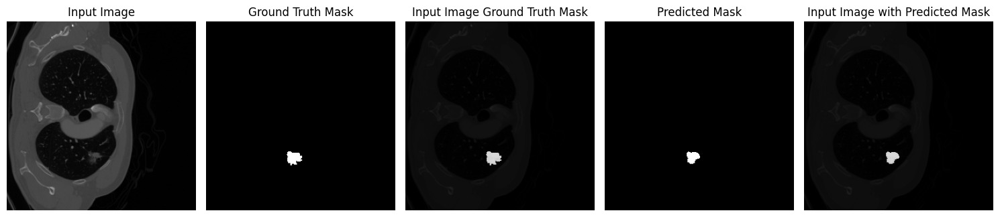

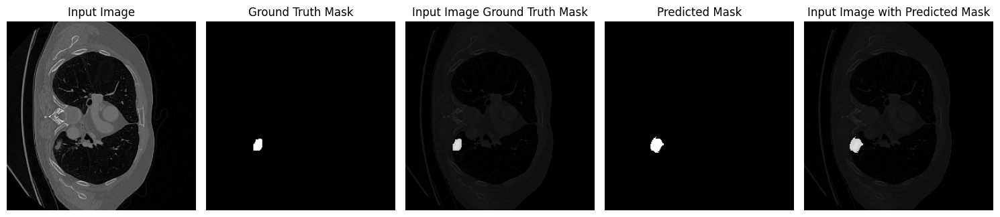

Epoch 42| Train_loss: 0.1296| Validate_loss: 0.5124| Val IOU: 0.3641| Val Best IOU 0.5910| Val Dice Coefficient 0.4897| lr 0.01| Accuracy 0.9990


Epoch 43/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


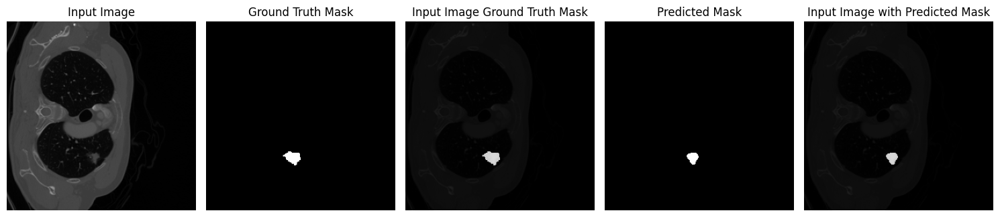

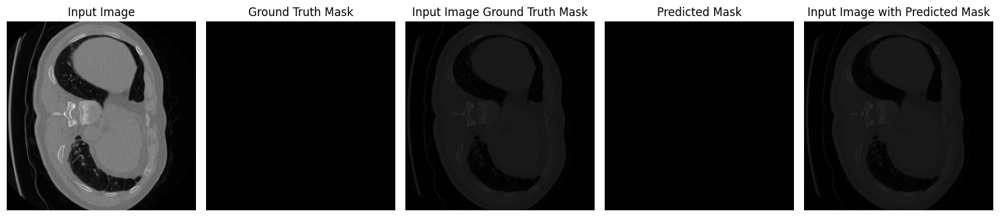

Epoch 43| Train_loss: 0.1300| Validate_loss: 0.4797| Val IOU: 0.4033| Val Best IOU 0.5910| Val Dice Coefficient 0.5244| lr 0.01| Accuracy 0.9992


Epoch 44/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


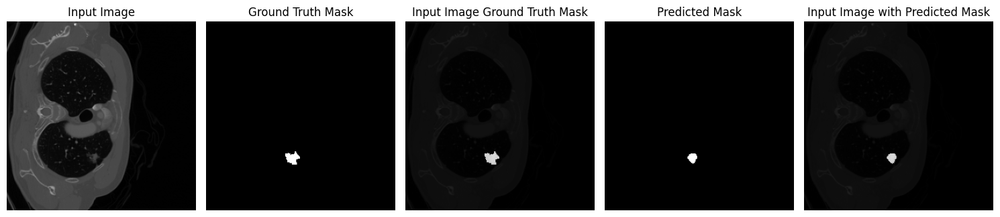

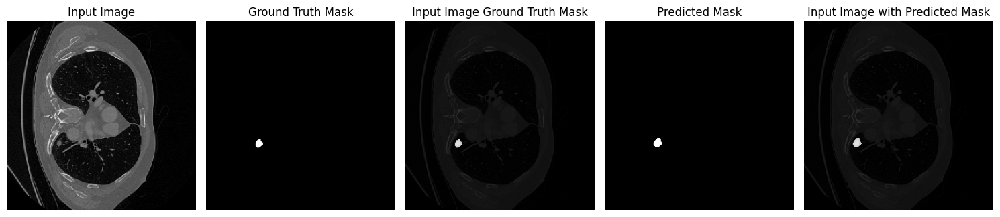

Epoch 44| Train_loss: 0.1236| Validate_loss: 0.3035| Val IOU: 0.5410| Val Best IOU 0.5910| Val Dice Coefficient 0.7008| lr 0.01| Accuracy 0.9992


Epoch 45/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


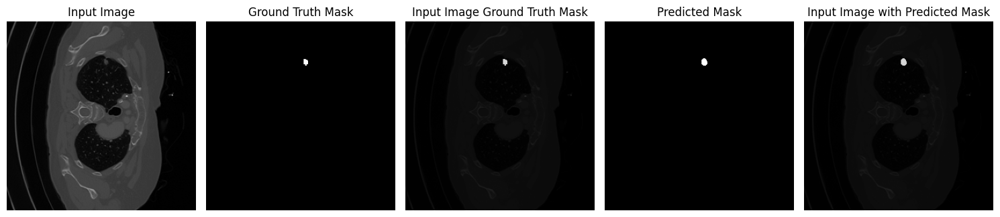

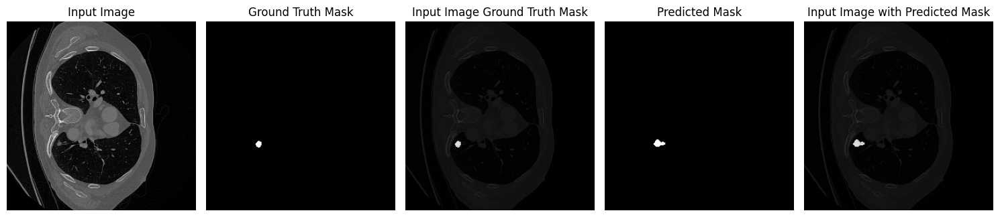

Epoch 45| Train_loss: 0.1242| Validate_loss: 0.2796| Val IOU: 0.5756| Val Best IOU 0.5910| Val Dice Coefficient 0.7260| lr 0.01| Accuracy 0.9992


Epoch 46/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


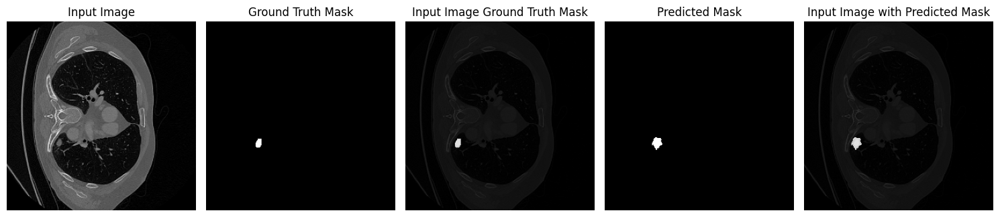

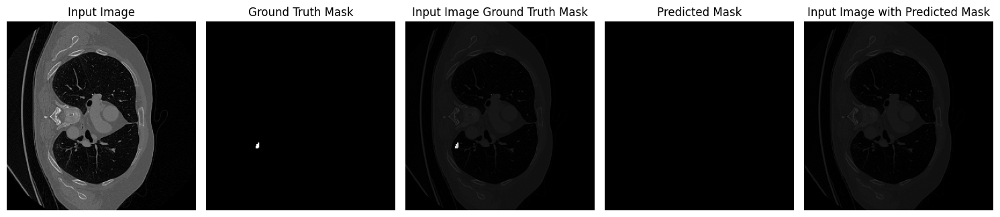

Epoch 46| Train_loss: 0.1199| Validate_loss: 0.3822| Val IOU: 0.4590| Val Best IOU 0.5910| Val Dice Coefficient 0.6259| lr 0.01| Accuracy 0.9986


Epoch 47/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


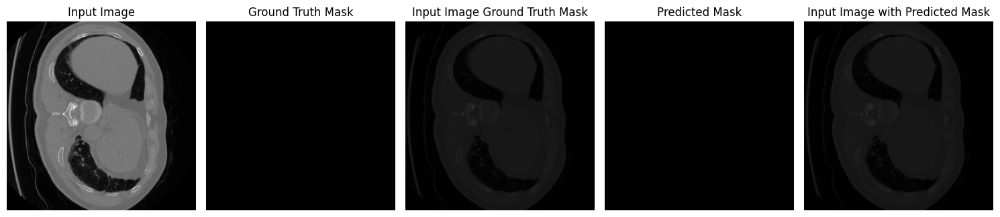

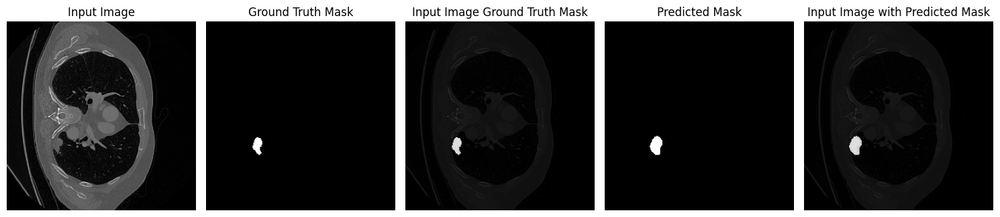

Epoch 47| Train_loss: 0.1213| Validate_loss: 0.4370| Val IOU: 0.4169| Val Best IOU 0.5910| Val Dice Coefficient 0.5682| lr 0.01| Accuracy 0.9991


Epoch 48/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


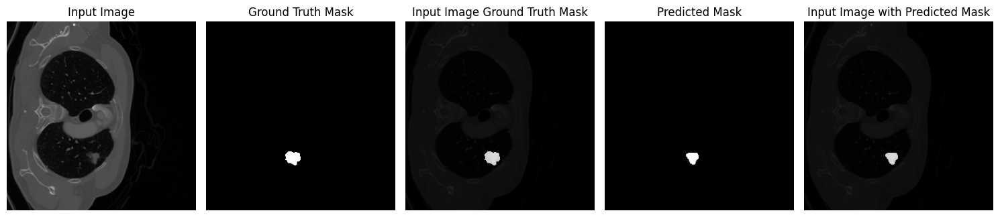

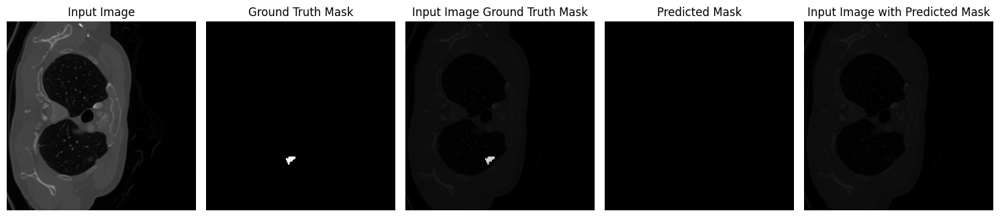

Epoch 48| Train_loss: 0.1217| Validate_loss: 0.3363| Val IOU: 0.5068| Val Best IOU 0.5910| Val Dice Coefficient 0.6704| lr 0.001| Accuracy 0.9990


Epoch 49/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


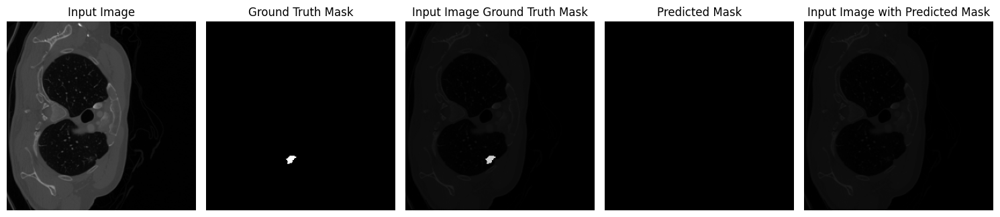

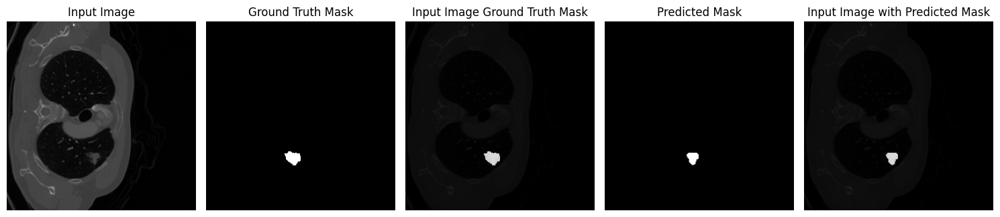

Epoch 49| Train_loss: 0.1160| Validate_loss: 0.3788| Val IOU: 0.4628| Val Best IOU 0.5910| Val Dice Coefficient 0.6292| lr 0.001| Accuracy 0.9990


Epoch 50/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


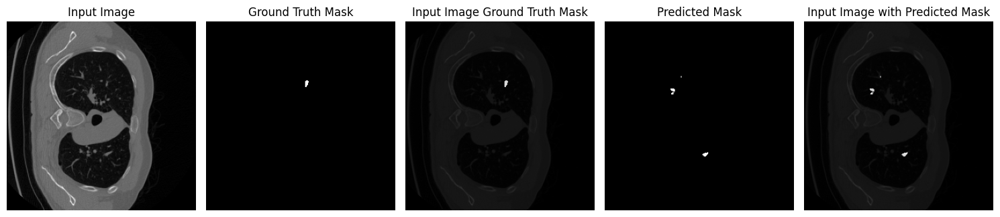

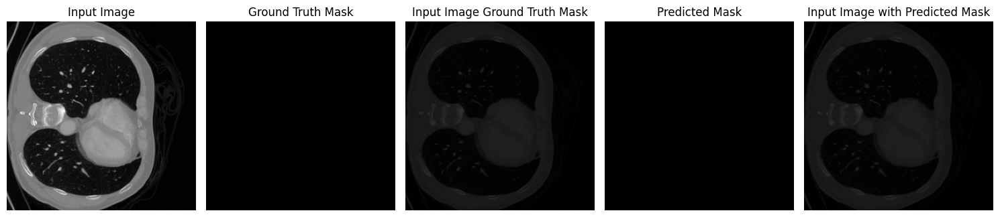

Epoch 50| Train_loss: 0.1118| Validate_loss: 0.2983| Val IOU: 0.5508| Val Best IOU 0.5910| Val Dice Coefficient 0.7060| lr 0.001| Accuracy 0.9991


Epoch 51/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


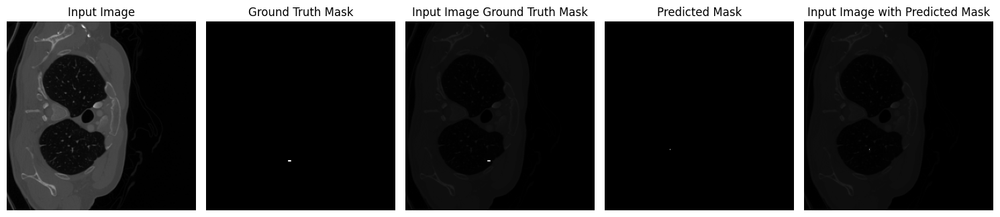

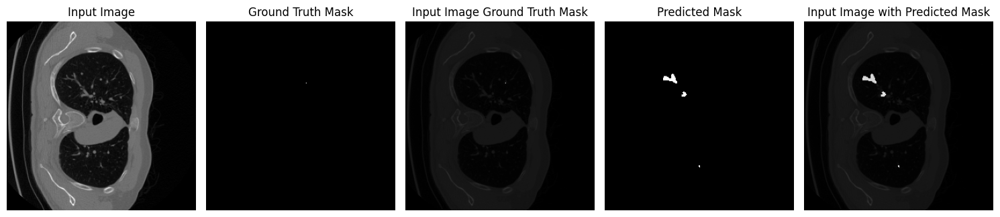

Epoch 51| Train_loss: 0.1097| Validate_loss: 0.2887| Val IOU: 0.5629| Val Best IOU 0.5910| Val Dice Coefficient 0.7166| lr 0.001| Accuracy 0.9993


Epoch 52/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


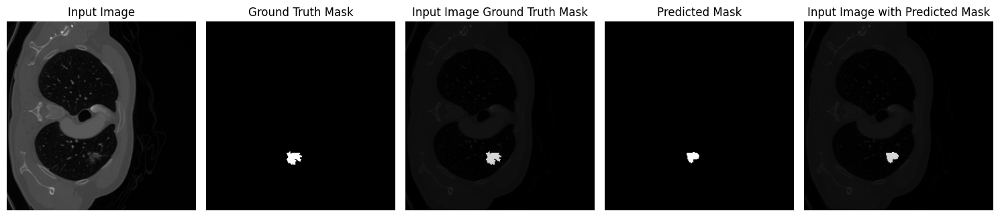

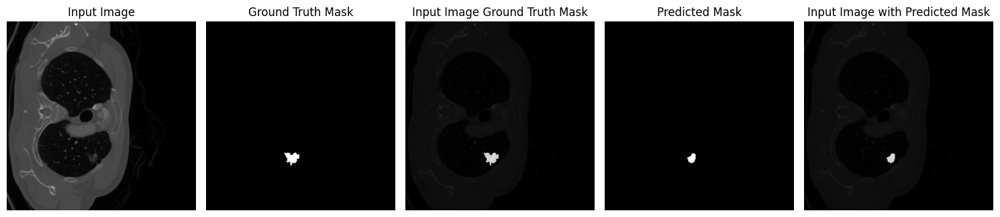

Epoch 52| Train_loss: 0.1090| Validate_loss: 0.3763| Val IOU: 0.4731| Val Best IOU 0.5910| Val Dice Coefficient 0.6313| lr 0.001| Accuracy 0.9988


Epoch 53/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


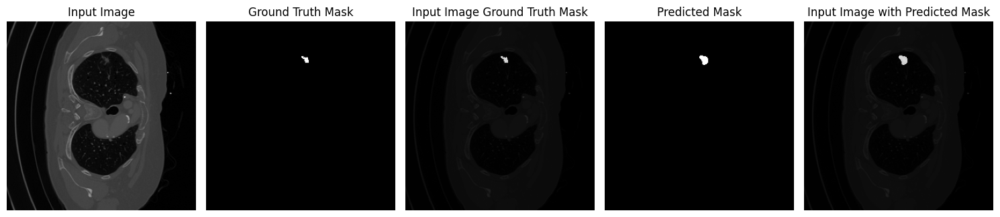

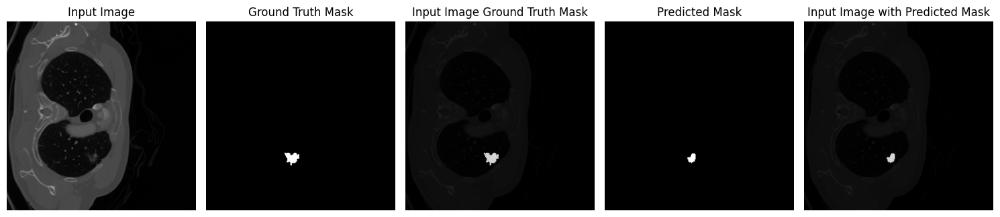

Epoch 53| Train_loss: 0.1123| Validate_loss: 0.4791| Val IOU: 0.4038| Val Best IOU 0.5910| Val Dice Coefficient 0.7739| lr 0.001| Accuracy 0.9993


Epoch 54/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


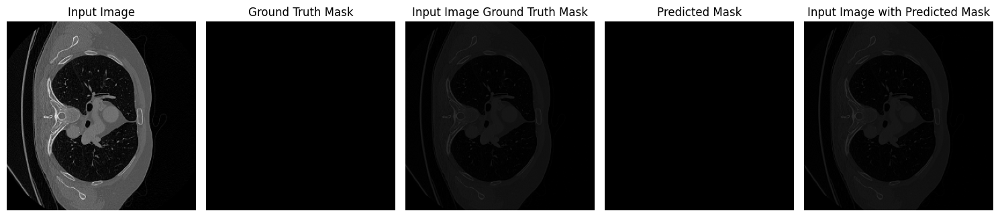

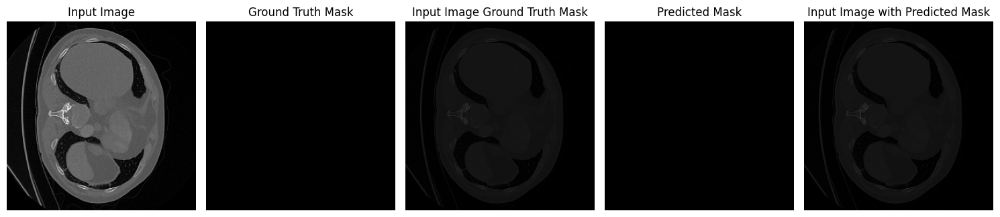

Epoch 54| Train_loss: 0.1087| Validate_loss: 0.4751| Val IOU: 0.4103| Val Best IOU 0.5910| Val Dice Coefficient 0.5285| lr 0.001| Accuracy 0.9991


Epoch 55/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


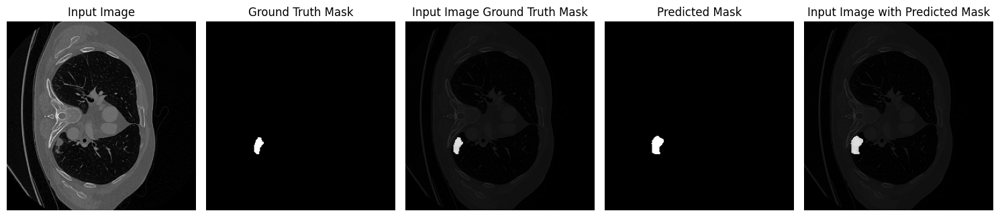

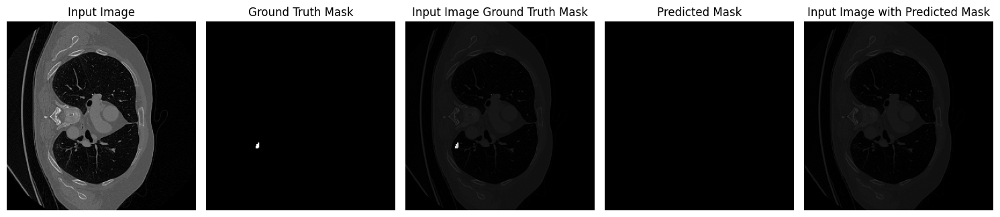

Epoch 55| Train_loss: 0.1075| Validate_loss: 0.3667| Val IOU: 0.4796| Val Best IOU 0.5910| Val Dice Coefficient 0.6389| lr 0.001| Accuracy 0.9991


Epoch 56/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


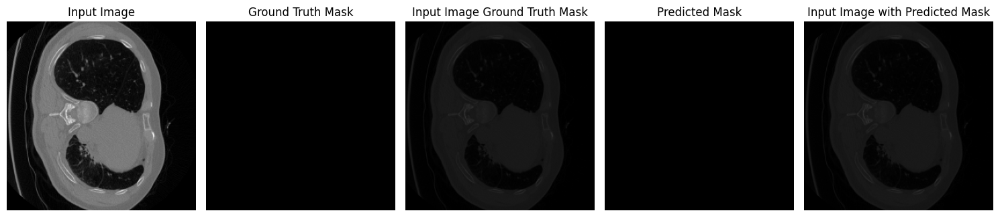

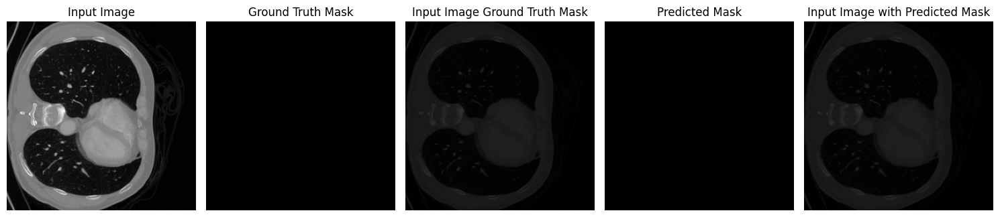

Epoch 56| Train_loss: 0.1076| Validate_loss: 0.3478| Val IOU: 0.4932| Val Best IOU 0.5910| Val Dice Coefficient 0.6549| lr 0.001| Accuracy 0.9990


Epoch 57/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


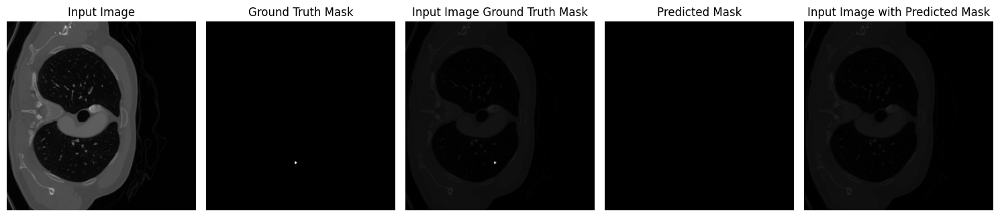

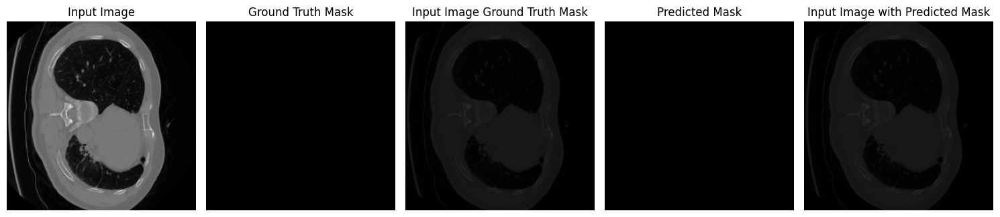

Epoch 57| Train_loss: 0.1065| Validate_loss: 0.2983| Val IOU: 0.5459| Val Best IOU 0.5910| Val Dice Coefficient 0.7056| lr 0.001| Accuracy 0.9992


Epoch 58/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


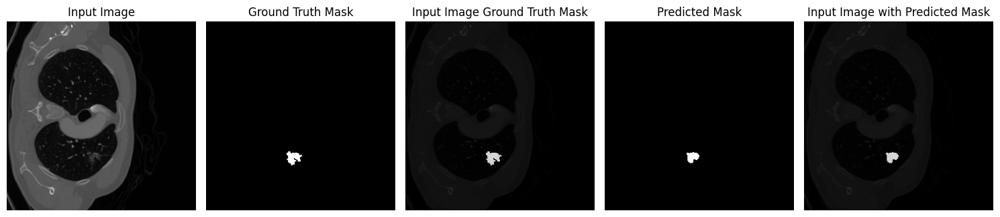

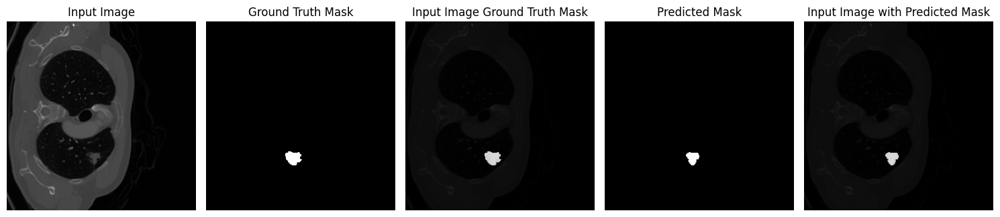

Epoch 58| Train_loss: 0.1057| Validate_loss: 0.4782| Val IOU: 0.4047| Val Best IOU 0.5910| Val Dice Coefficient 0.5247| lr 0.001| Accuracy 0.9993


Epoch 59/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


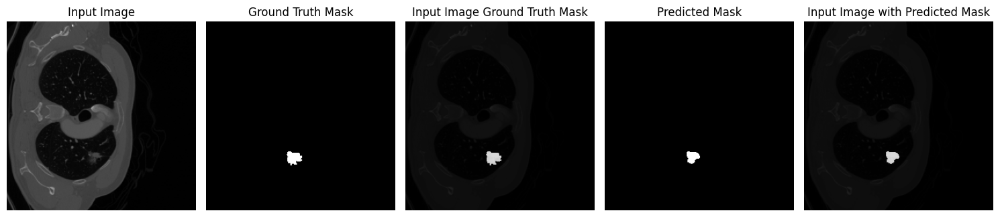

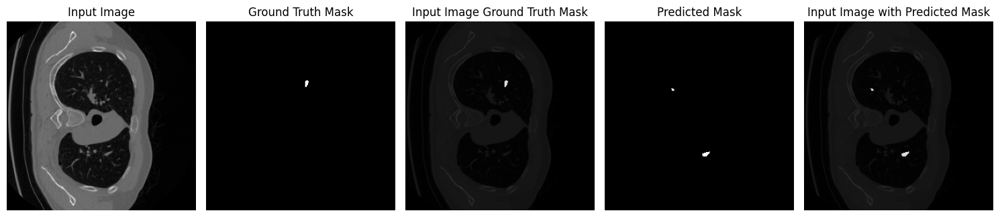

Epoch 59| Train_loss: 0.1074| Validate_loss: 0.4714| Val IOU: 0.4129| Val Best IOU 0.5910| Val Dice Coefficient 0.5319| lr 0.001| Accuracy 0.9992


Epoch 60/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


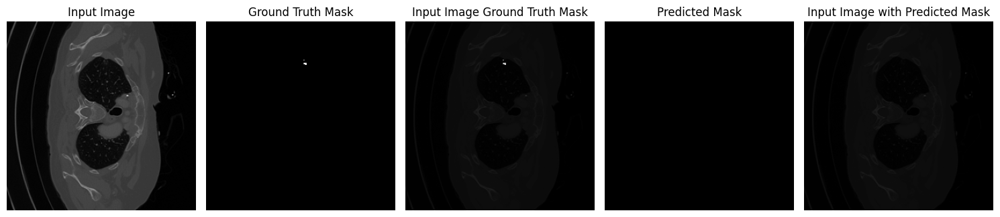

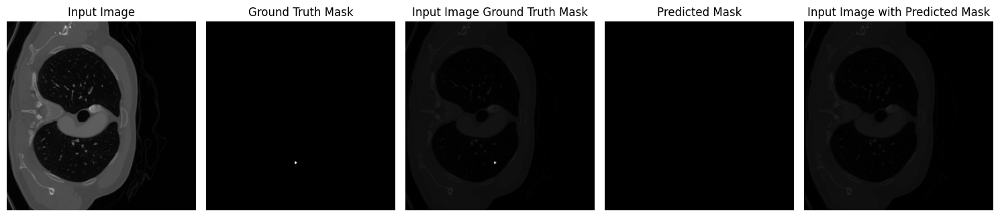

Epoch 60| Train_loss: 0.1079| Validate_loss: 0.2650| Val IOU: 0.5892| Val Best IOU 0.5910| Val Dice Coefficient 0.7386| lr 0.001| Accuracy 0.9991


Epoch 61/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


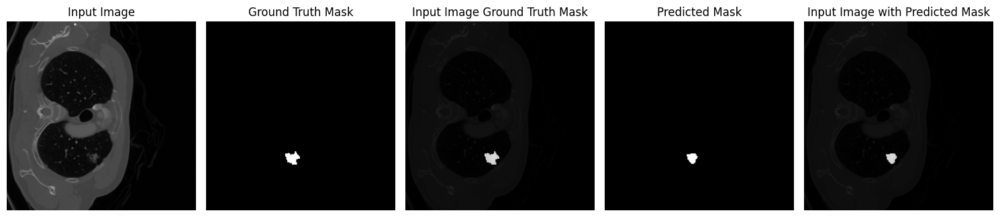

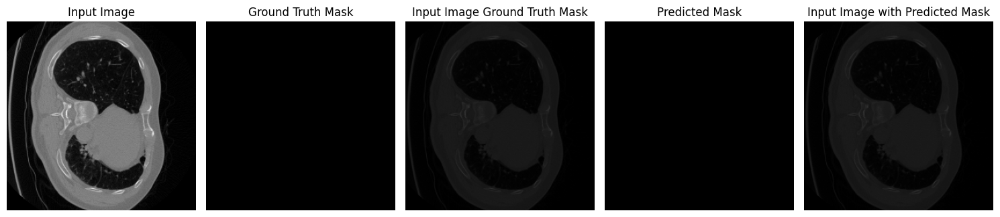

Epoch 61| Train_loss: 0.1064| Validate_loss: 0.4656| Val IOU: 0.4196| Val Best IOU 0.5910| Val Dice Coefficient 0.5381| lr 0.001| Accuracy 0.9990


Epoch 62/100: 100%|██████████| 58/58 [00:22<00:00,  2.64it/s]


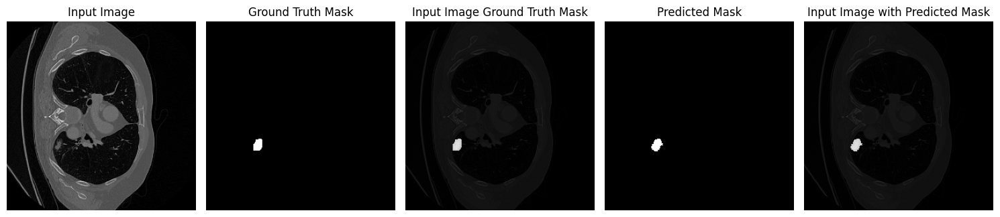

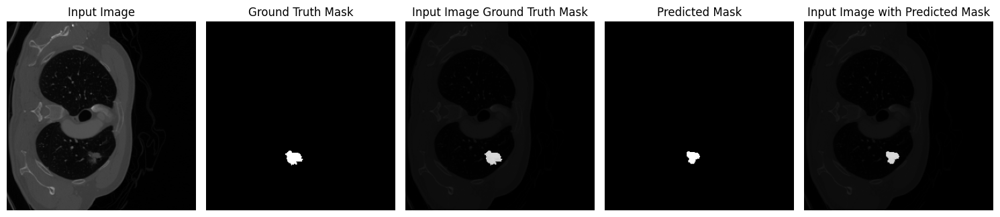

Epoch 62| Train_loss: 0.1052| Validate_loss: 0.3115| Val IOU: 0.5325| Val Best IOU 0.5910| Val Dice Coefficient 0.6935| lr 0.001| Accuracy 0.9992


Epoch 63/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


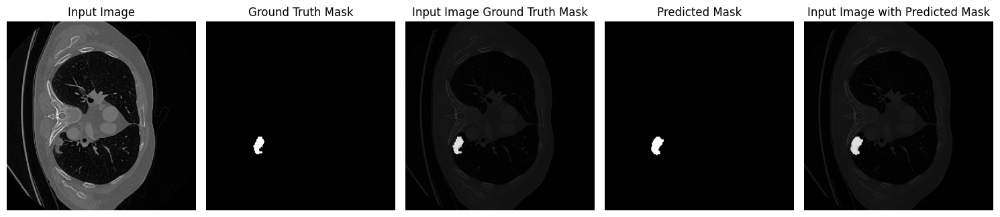

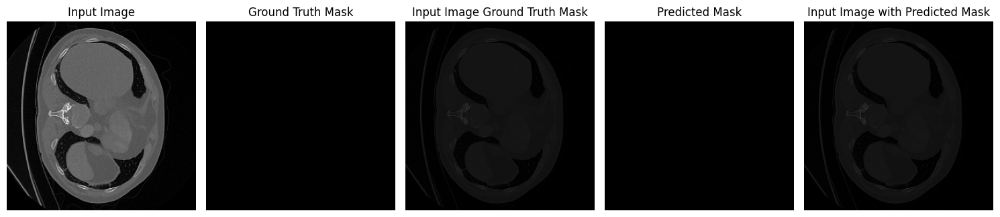

Epoch 63| Train_loss: 0.1056| Validate_loss: 0.3222| Val IOU: 0.5217| Val Best IOU 0.5910| Val Dice Coefficient 0.6817| lr 0.001| Accuracy 0.9991


Epoch 64/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


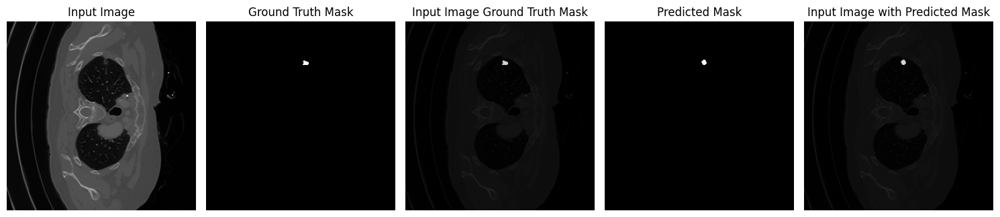

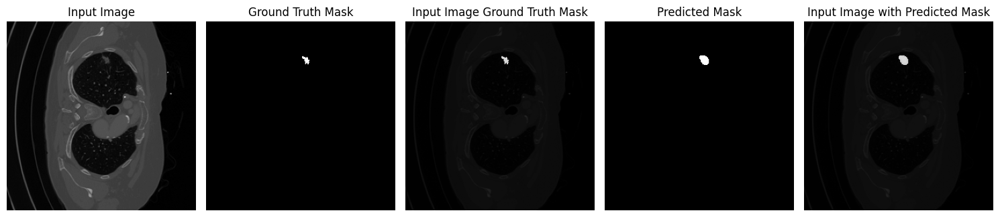

Achieved Better IOU with 0.5976017862558365, Than 0.5909661948680878
Epoch 64| Train_loss: 0.1078| Validate_loss: 0.2610| Val IOU: 0.5976| Val Best IOU 0.5976| Val Dice Coefficient 0.7438| lr 0.001| Accuracy 0.9992


Epoch 65/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


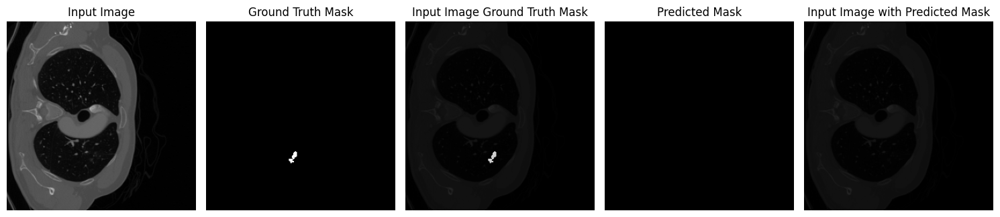

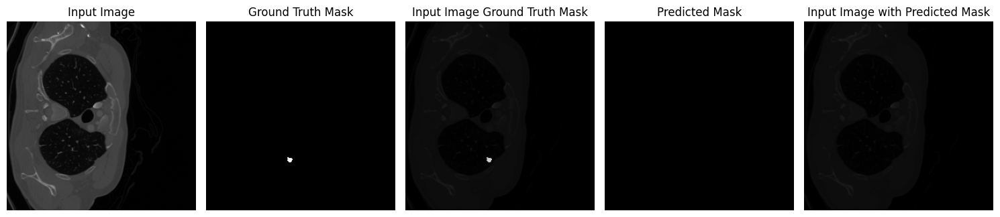

Epoch 65| Train_loss: 0.1054| Validate_loss: 0.3341| Val IOU: 0.5123| Val Best IOU 0.5976| Val Dice Coefficient 0.6712| lr 0.001| Accuracy 0.9991


Epoch 66/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


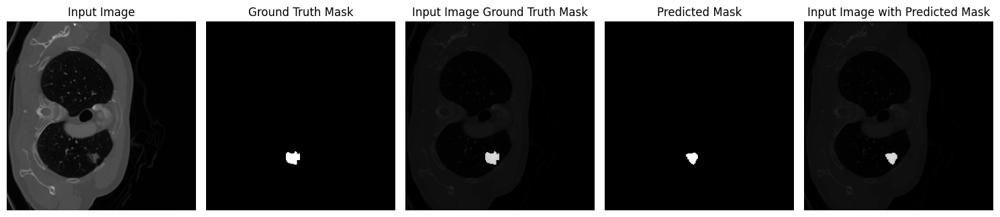

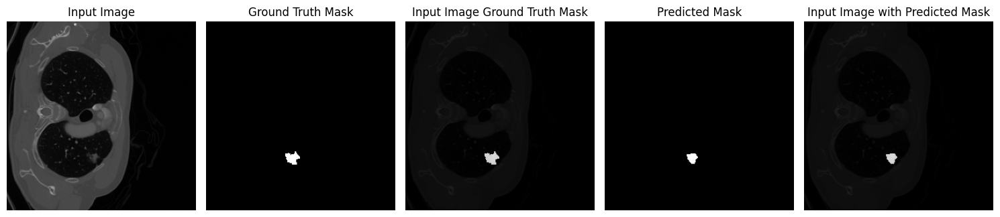

Achieved Better IOU with 0.6157662719488144, Than 0.5976017862558365
Epoch 66| Train_loss: 0.1040| Validate_loss: 0.2440| Val IOU: 0.6158| Val Best IOU 0.6158| Val Dice Coefficient 0.7590| lr 0.001| Accuracy 0.9993


Epoch 67/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


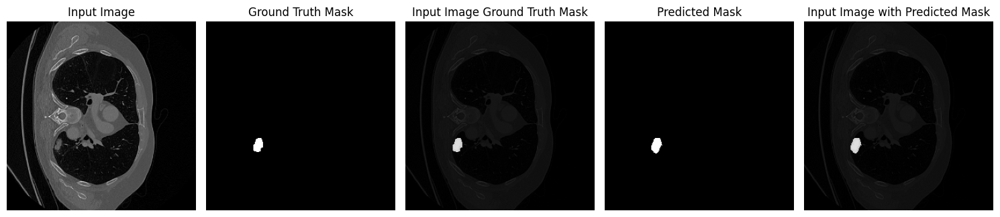

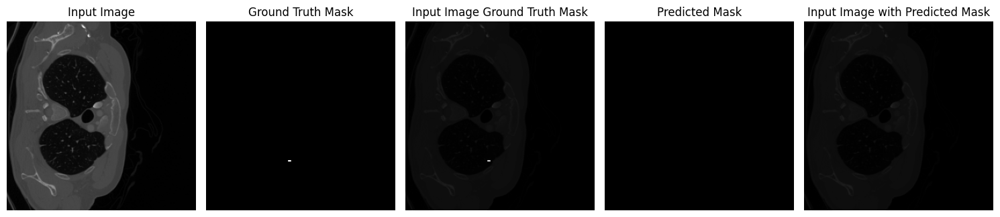

Epoch 67| Train_loss: 0.1037| Validate_loss: 0.2995| Val IOU: 0.5451| Val Best IOU 0.6158| Val Dice Coefficient 0.7047| lr 0.001| Accuracy 0.9991


Epoch 68/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


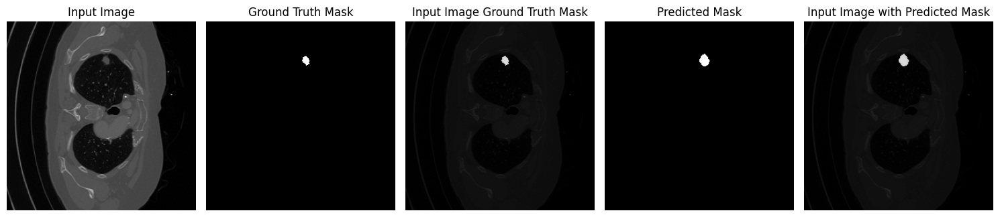

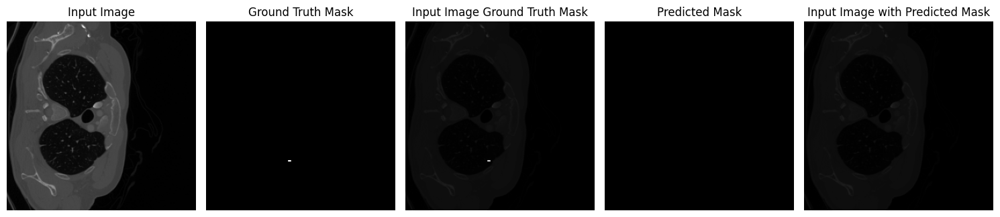

Epoch 68| Train_loss: 0.1045| Validate_loss: 0.4579| Val IOU: 0.4279| Val Best IOU 0.6158| Val Dice Coefficient 0.7947| lr 0.001| Accuracy 0.9994


Epoch 69/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


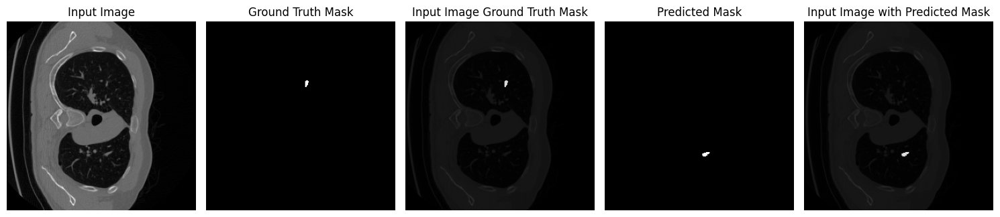

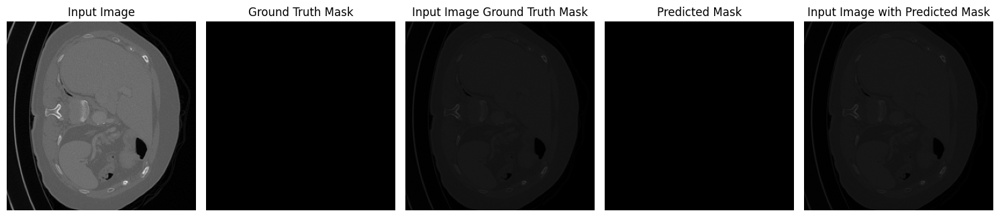

Epoch 69| Train_loss: 0.1041| Validate_loss: 0.2826| Val IOU: 0.5648| Val Best IOU 0.6158| Val Dice Coefficient 0.7219| lr 0.001| Accuracy 0.9992


Epoch 70/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


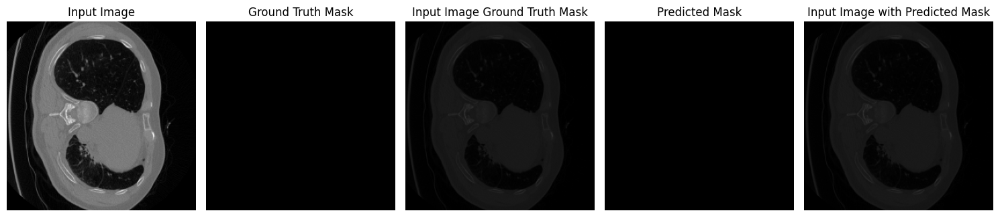

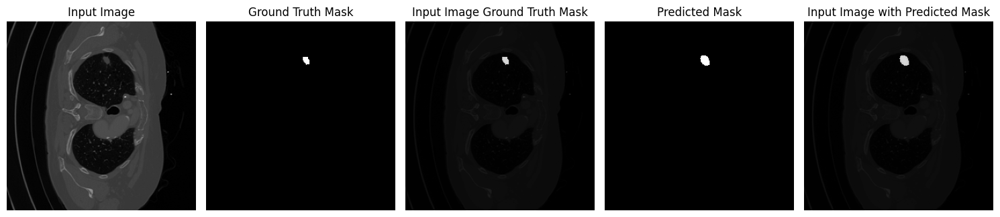

Epoch 70| Train_loss: 0.1024| Validate_loss: 0.4690| Val IOU: 0.4152| Val Best IOU 0.6158| Val Dice Coefficient 0.7841| lr 0.001| Accuracy 0.9994


Epoch 71/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


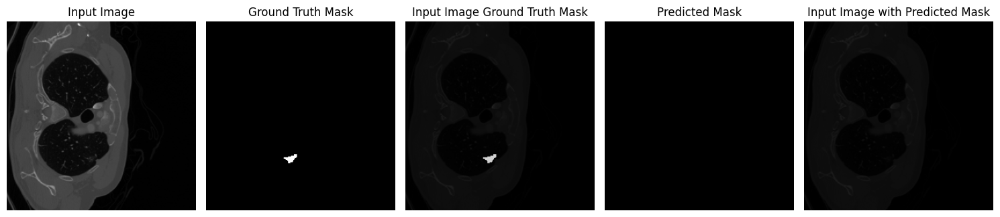

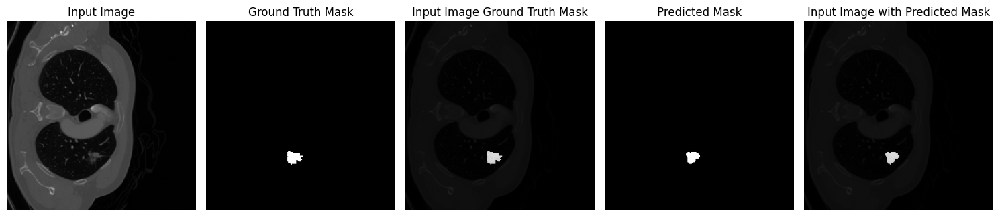

Epoch 71| Train_loss: 0.1050| Validate_loss: 0.3879| Val IOU: 0.4656| Val Best IOU 0.6158| Val Dice Coefficient 0.6189| lr 0.001| Accuracy 0.9991


Epoch 72/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


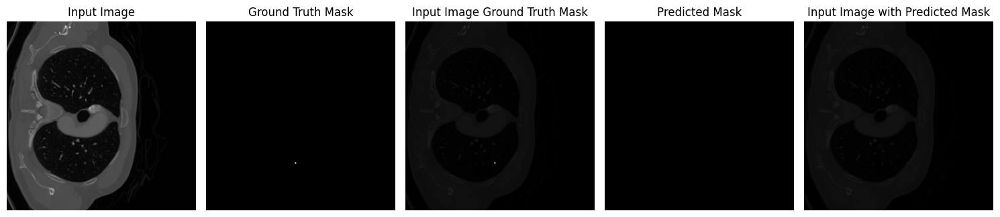

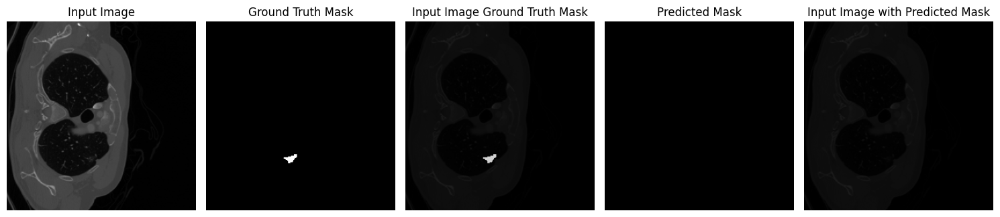

Epoch 72| Train_loss: 0.1035| Validate_loss: 0.2585| Val IOU: 0.5972| Val Best IOU 0.6158| Val Dice Coefficient 0.7445| lr 0.001| Accuracy 0.9992


Epoch 73/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


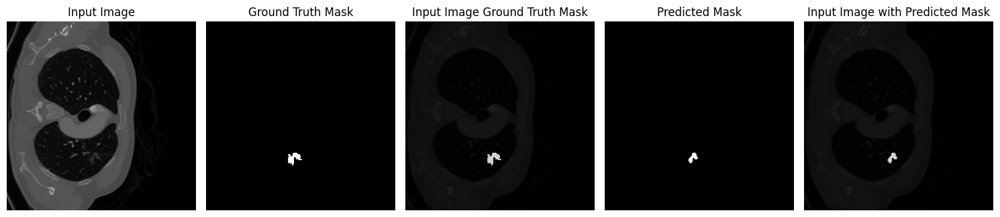

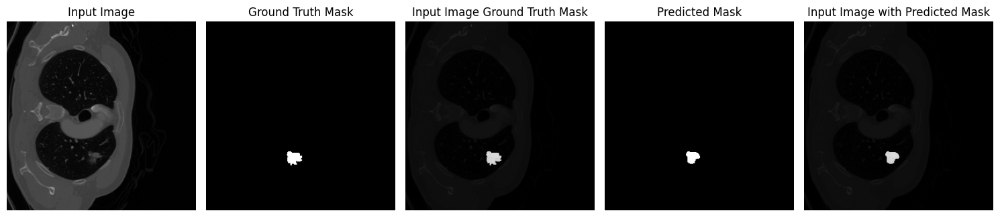

Epoch 73| Train_loss: 0.1043| Validate_loss: 0.4572| Val IOU: 0.4314| Val Best IOU 0.6158| Val Dice Coefficient 0.5469| lr 0.001| Accuracy 0.9992


Epoch 74/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


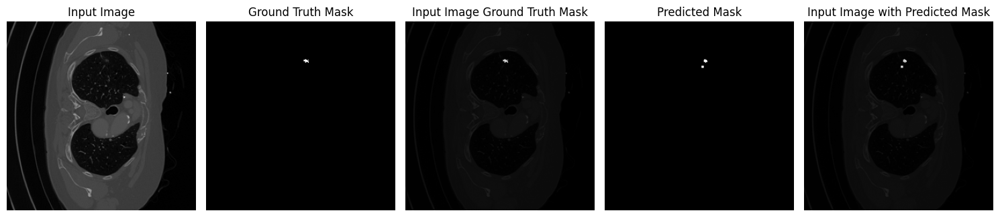

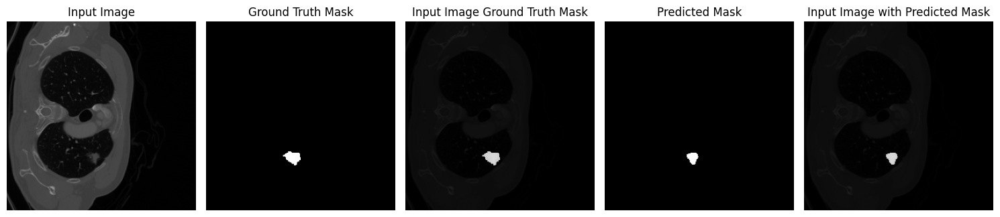

Epoch 74| Train_loss: 0.1037| Validate_loss: 0.3597| Val IOU: 0.4851| Val Best IOU 0.6158| Val Dice Coefficient 0.6422| lr 0.001| Accuracy 0.9991


Epoch 75/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


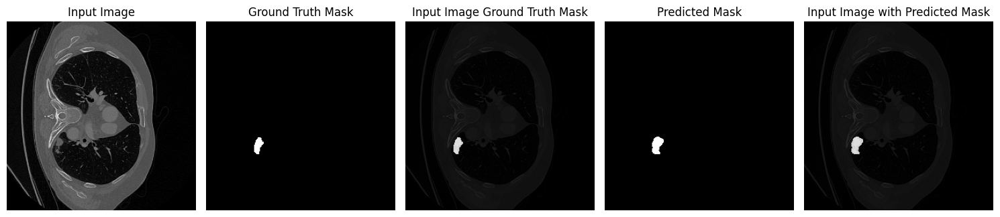

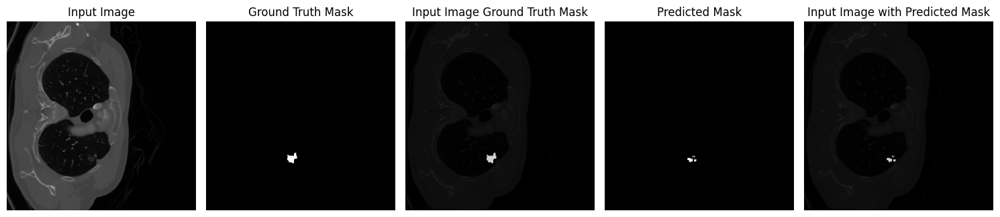

Epoch 75| Train_loss: 0.1009| Validate_loss: 0.2603| Val IOU: 0.5967| Val Best IOU 0.6158| Val Dice Coefficient 0.7447| lr 0.001| Accuracy 0.9991


Epoch 76/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


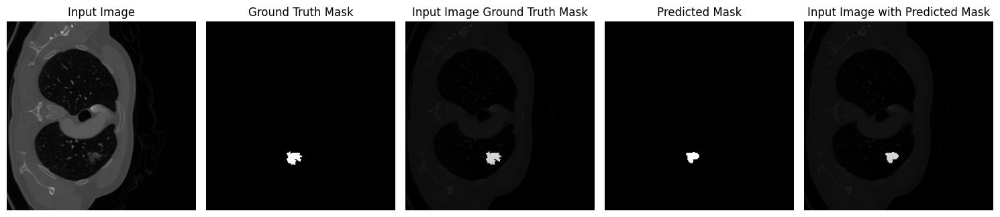

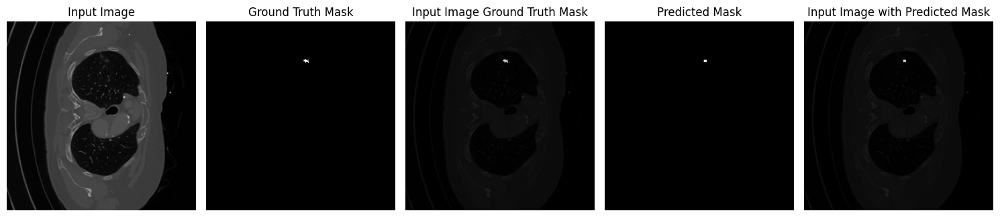

Epoch 76| Train_loss: 0.1048| Validate_loss: 0.4673| Val IOU: 0.4194| Val Best IOU 0.6158| Val Dice Coefficient 0.5365| lr 0.001| Accuracy 0.9991


Epoch 77/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


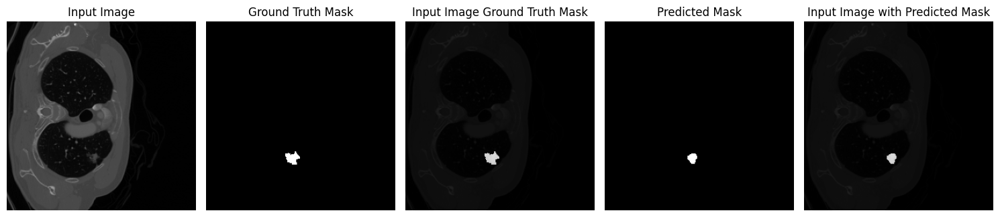

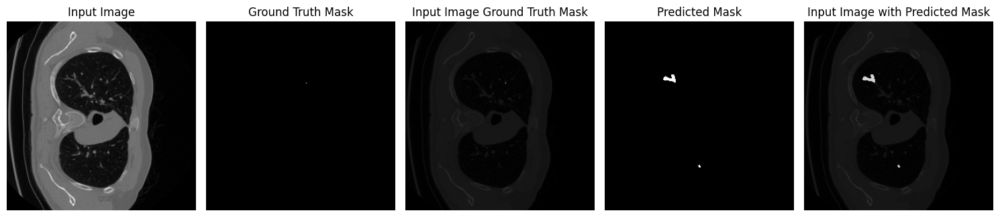

Epoch 77| Train_loss: 0.1023| Validate_loss: 0.3357| Val IOU: 0.5054| Val Best IOU 0.6158| Val Dice Coefficient 0.6663| lr 0.001| Accuracy 0.9992


Epoch 78/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


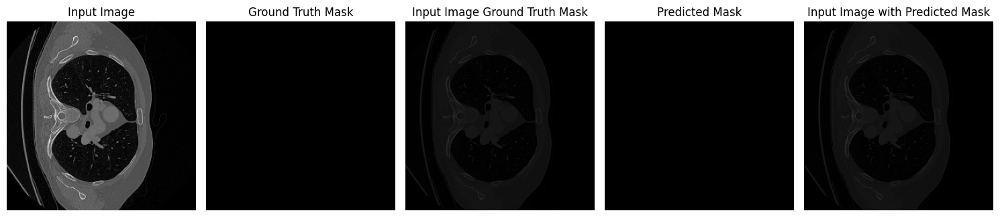

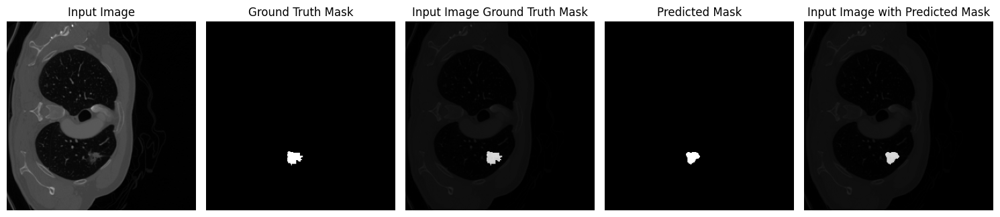

Epoch 78| Train_loss: 0.1010| Validate_loss: 0.2812| Val IOU: 0.5653| Val Best IOU 0.6158| Val Dice Coefficient 0.7221| lr 0.001| Accuracy 0.9991


Epoch 79/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


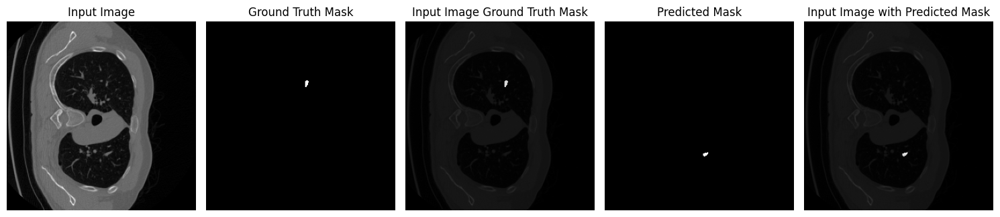

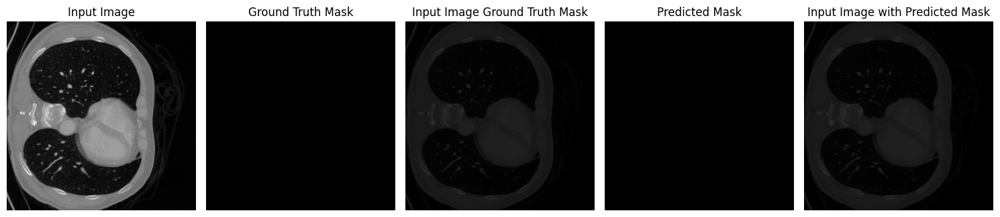

Epoch 79| Train_loss: 0.1035| Validate_loss: 0.2946| Val IOU: 0.5506| Val Best IOU 0.6158| Val Dice Coefficient 0.7096| lr 0.001| Accuracy 0.9990


Epoch 80/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


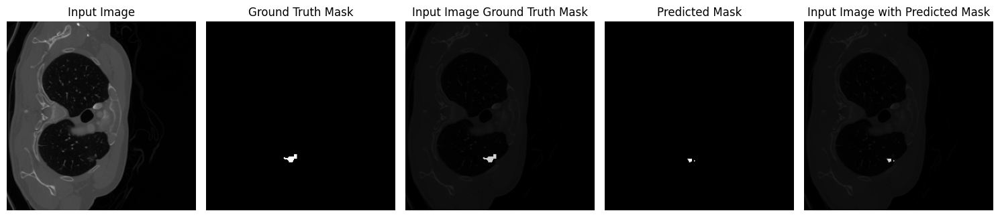

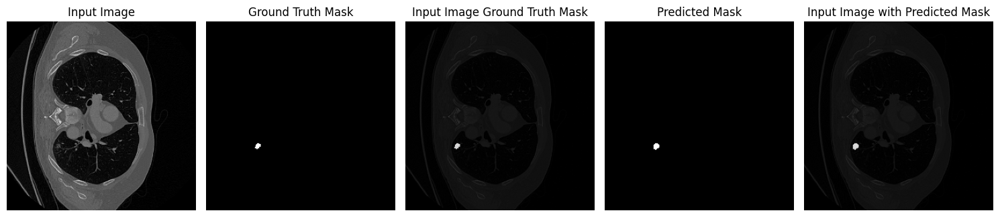

Epoch 80| Train_loss: 0.1020| Validate_loss: 0.3325| Val IOU: 0.5121| Val Best IOU 0.6158| Val Dice Coefficient 0.6709| lr 0.001| Accuracy 0.9992


Epoch 81/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


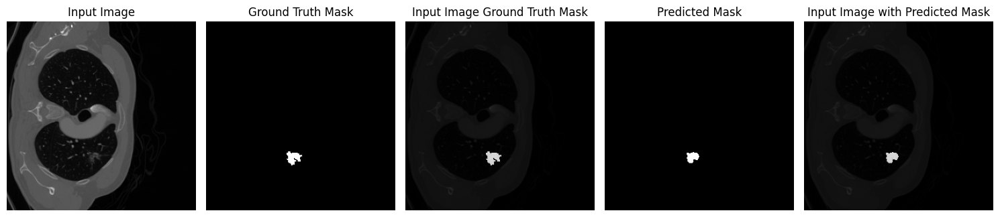

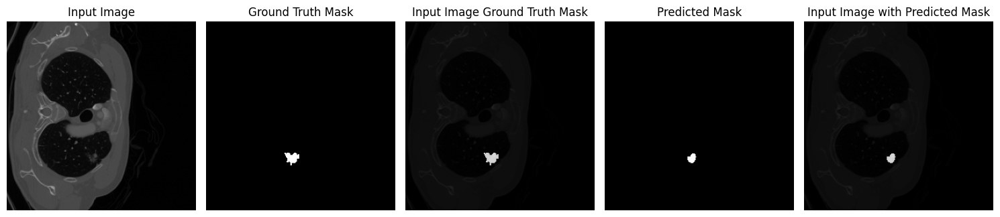

Epoch 81| Train_loss: 0.1022| Validate_loss: 0.3050| Val IOU: 0.5378| Val Best IOU 0.6158| Val Dice Coefficient 0.6978| lr 0.001| Accuracy 0.9990


Epoch 82/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


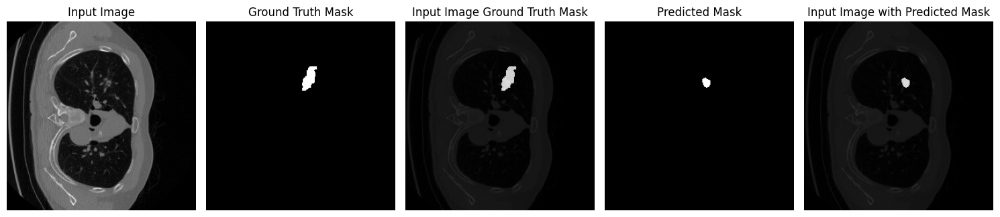

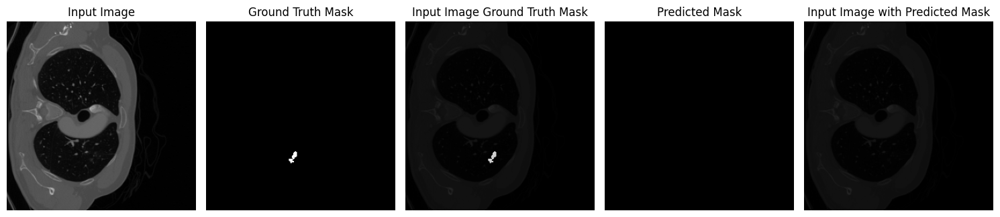

Epoch 82| Train_loss: 0.1005| Validate_loss: 0.2789| Val IOU: 0.5701| Val Best IOU 0.6158| Val Dice Coefficient 0.7259| lr 0.001| Accuracy 0.9991


Epoch 83/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


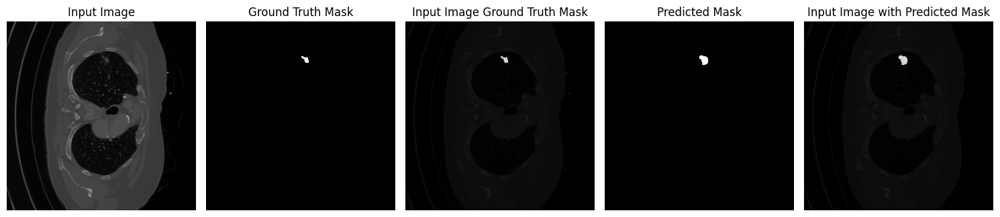

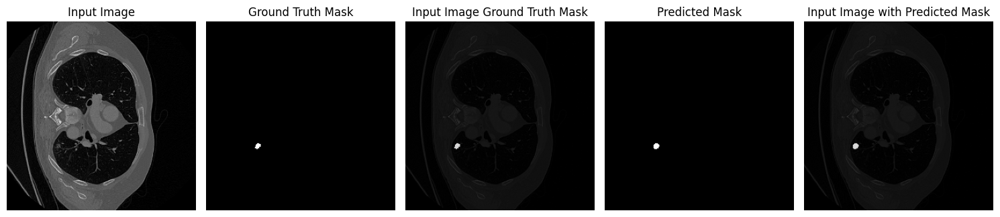

Epoch 83| Train_loss: 0.1008| Validate_loss: 0.2660| Val IOU: 0.5851| Val Best IOU 0.6158| Val Dice Coefficient 0.7376| lr 0.001| Accuracy 0.9992


Epoch 84/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


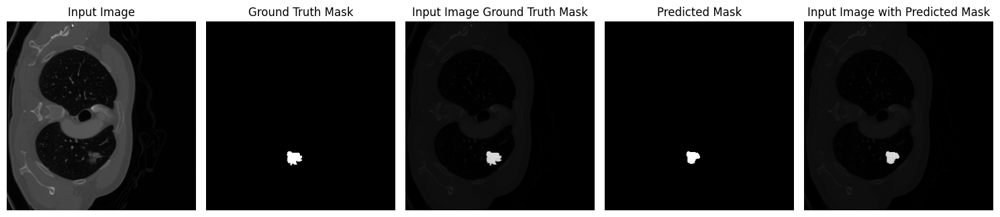

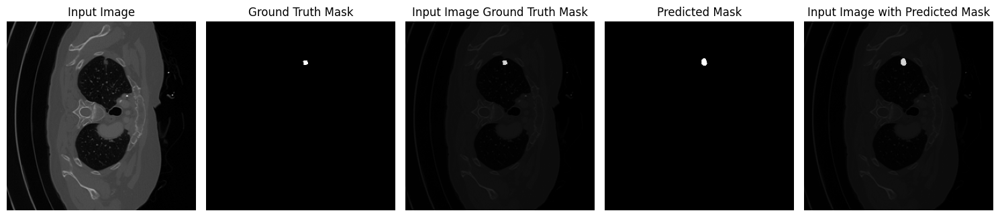

Epoch 84| Train_loss: 0.1012| Validate_loss: 0.3305| Val IOU: 0.5124| Val Best IOU 0.6158| Val Dice Coefficient 0.6714| lr 0.001| Accuracy 0.9991


Epoch 85/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


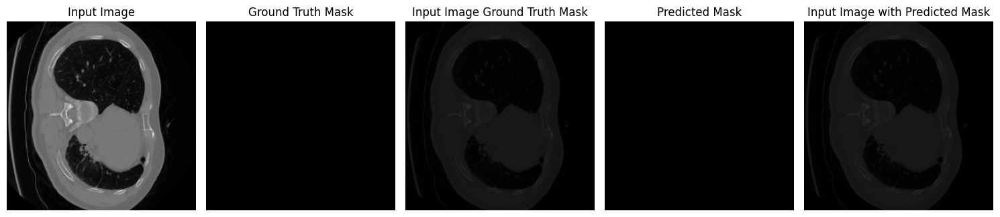

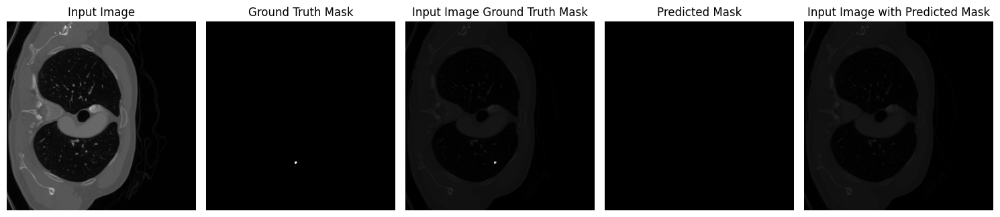

Epoch 85| Train_loss: 0.0998| Validate_loss: 0.2801| Val IOU: 0.5672| Val Best IOU 0.6158| Val Dice Coefficient 0.7232| lr 0.001| Accuracy 0.9991


Epoch 86/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


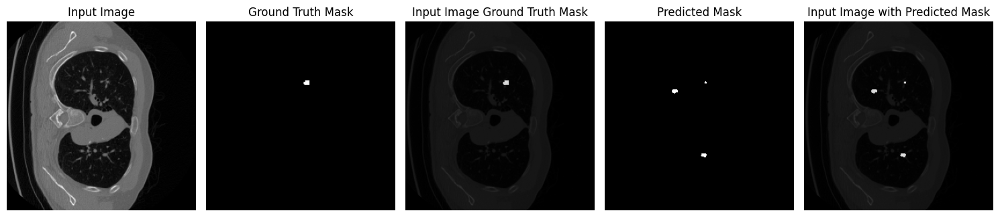

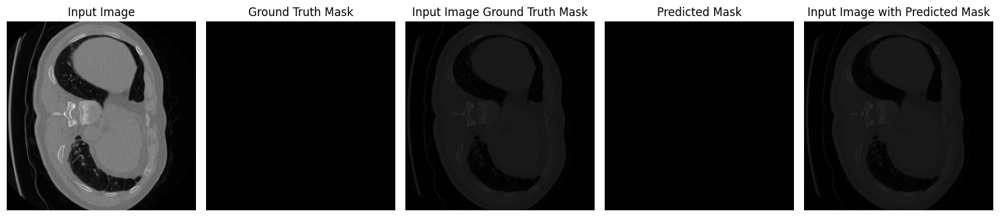

Epoch 86| Train_loss: 0.0999| Validate_loss: 0.2597| Val IOU: 0.5978| Val Best IOU 0.6158| Val Dice Coefficient 0.7439| lr 0.001| Accuracy 0.9992


Epoch 87/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


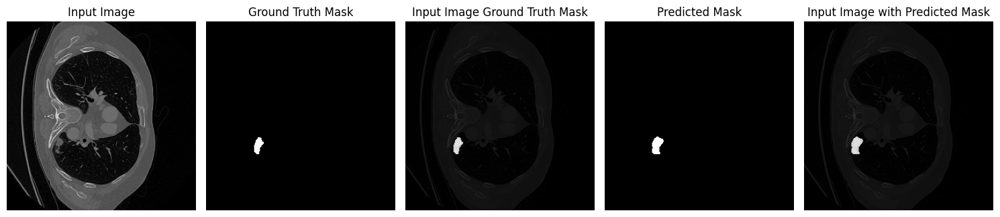

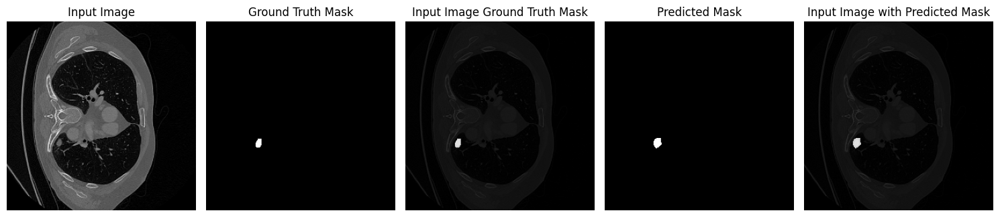

Epoch 87| Train_loss: 0.1001| Validate_loss: 0.2598| Val IOU: 0.5954| Val Best IOU 0.6158| Val Dice Coefficient 0.7440| lr 0.0001| Accuracy 0.9992


Epoch 88/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


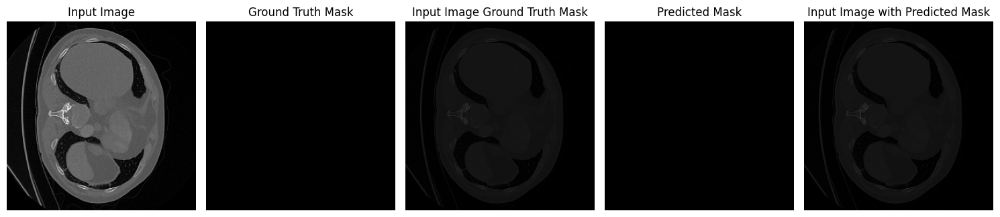

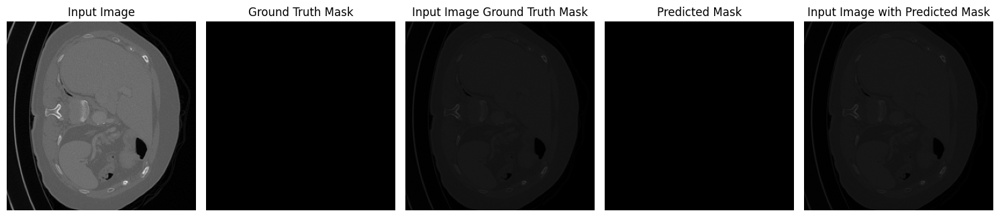

Epoch 88| Train_loss: 0.0988| Validate_loss: 0.3595| Val IOU: 0.4923| Val Best IOU 0.6158| Val Dice Coefficient 0.6452| lr 0.0001| Accuracy 0.9991


Epoch 89/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


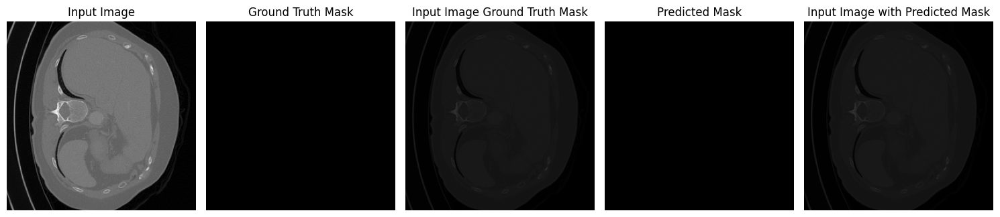

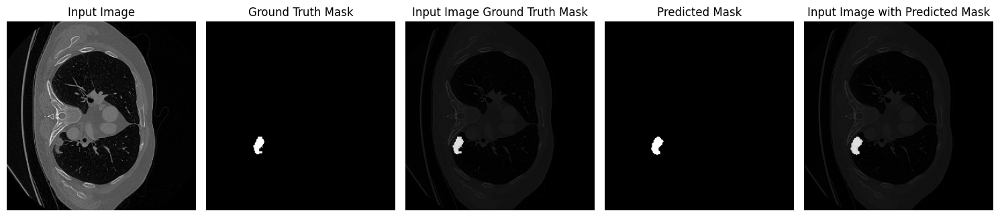

Epoch 89| Train_loss: 0.0985| Validate_loss: 0.4617| Val IOU: 0.4262| Val Best IOU 0.6158| Val Dice Coefficient 0.5430| lr 0.0001| Accuracy 0.9992


Epoch 90/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


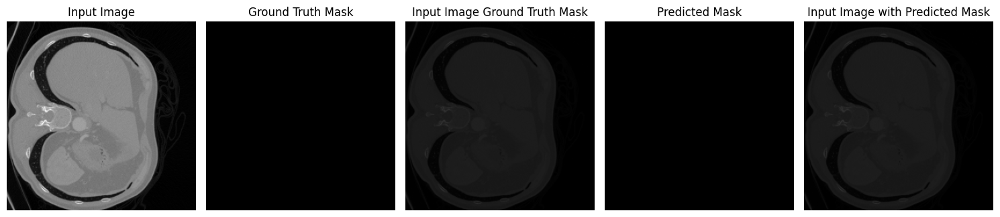

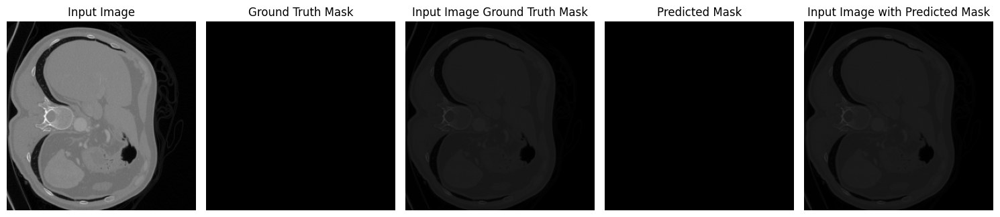

Epoch 90| Train_loss: 0.0977| Validate_loss: 0.2855| Val IOU: 0.5628| Val Best IOU 0.6158| Val Dice Coefficient 0.7195| lr 0.0001| Accuracy 0.9991


Epoch 91/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


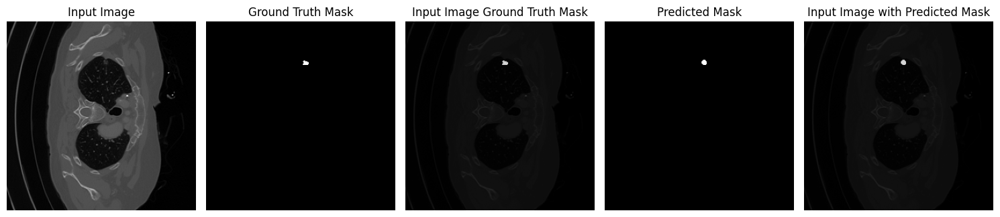

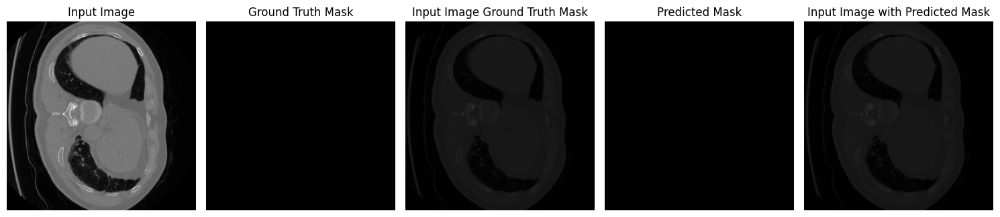

Epoch 91| Train_loss: 0.1005| Validate_loss: 0.3054| Val IOU: 0.5366| Val Best IOU 0.6158| Val Dice Coefficient 0.6970| lr 0.0001| Accuracy 0.9993


Epoch 92/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


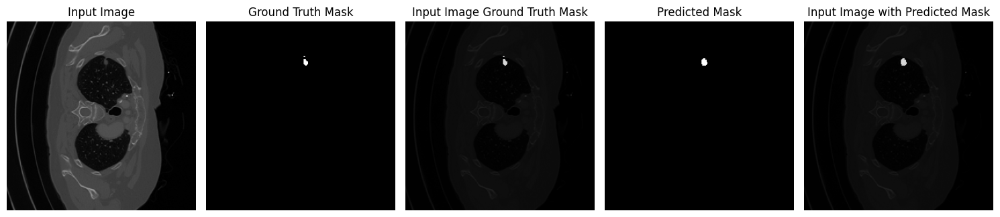

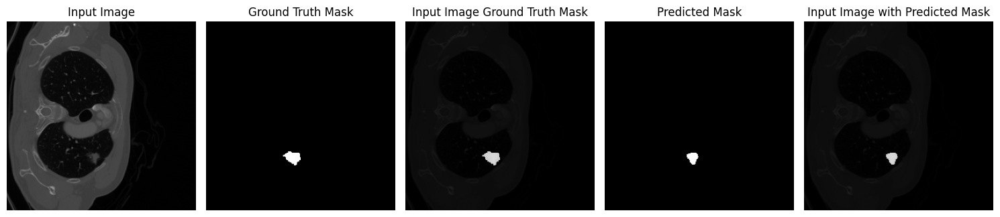

Epoch 92| Train_loss: 0.1001| Validate_loss: 0.3364| Val IOU: 0.5126| Val Best IOU 0.6158| Val Dice Coefficient 0.6711| lr 0.0001| Accuracy 0.9990


Epoch 93/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


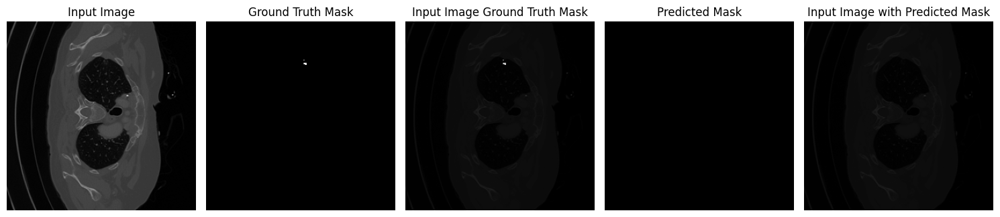

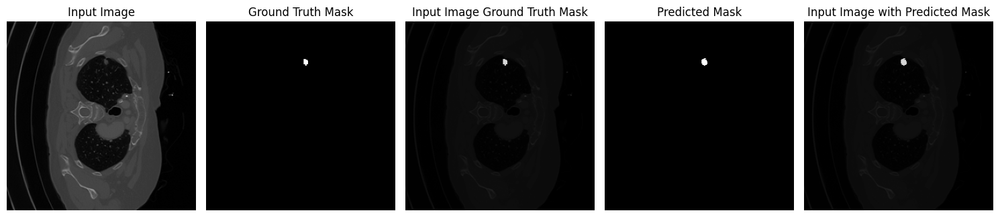

Achieved Better IOU with 0.6215258687734604, Than 0.6157662719488144
Epoch 93| Train_loss: 0.0988| Validate_loss: 0.2425| Val IOU: 0.6215| Val Best IOU 0.6215| Val Dice Coefficient 0.7615| lr 0.0001| Accuracy 0.9993


Epoch 94/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


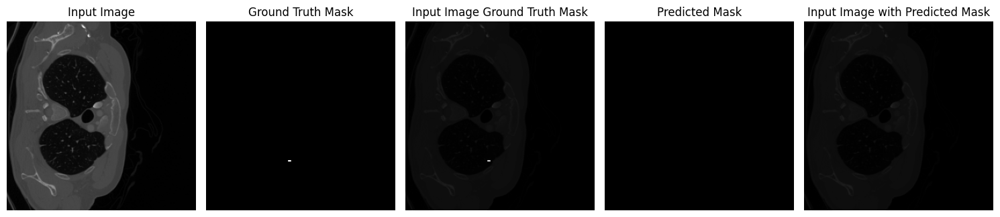

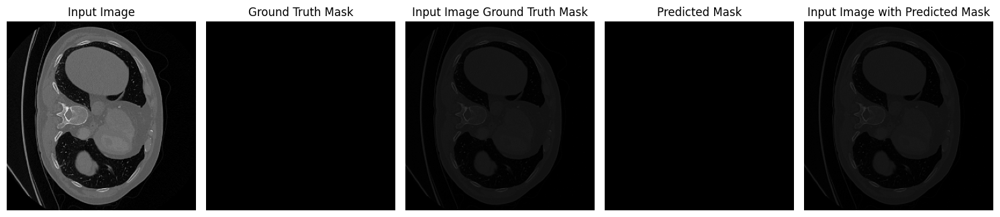

Achieved Better IOU with 0.6289187371730804, Than 0.6215258687734604
Epoch 94| Train_loss: 0.0998| Validate_loss: 0.2373| Val IOU: 0.6289| Val Best IOU 0.6289| Val Dice Coefficient 0.7662| lr 0.0001| Accuracy 0.9993


Epoch 95/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


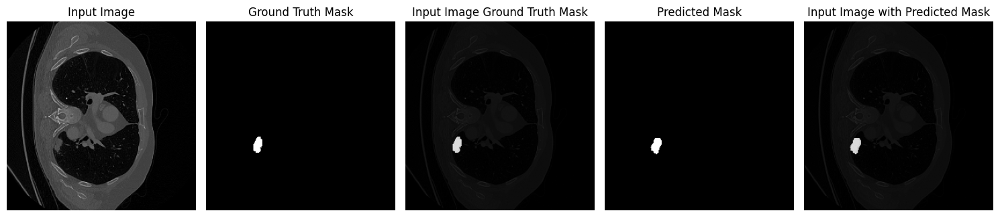

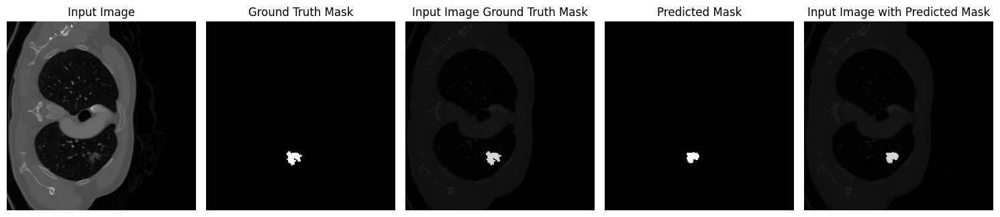

Epoch 95| Train_loss: 0.0977| Validate_loss: 0.3511| Val IOU: 0.4999| Val Best IOU 0.6289| Val Dice Coefficient 0.6559| lr 0.0001| Accuracy 0.9987


Epoch 96/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


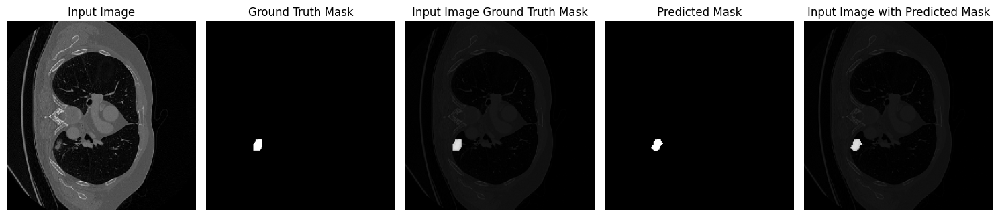

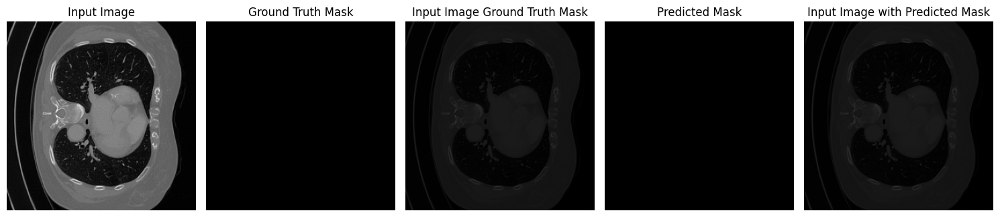

Epoch 96| Train_loss: 0.0991| Validate_loss: 0.3196| Val IOU: 0.5242| Val Best IOU 0.6289| Val Dice Coefficient 0.6847| lr 0.0001| Accuracy 0.9993


Epoch 97/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


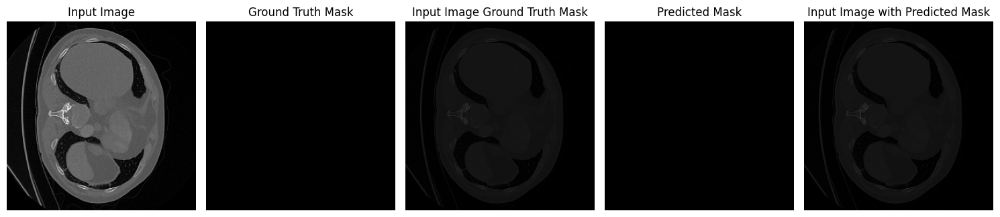

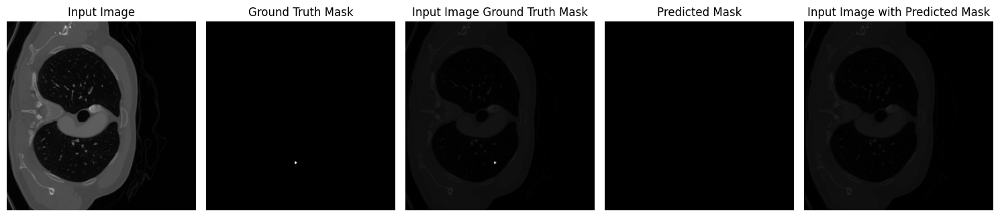

Epoch 97| Train_loss: 0.0970| Validate_loss: 0.4566| Val IOU: 0.4308| Val Best IOU 0.6289| Val Dice Coefficient 0.5470| lr 0.0001| Accuracy 0.9993


Epoch 98/100: 100%|██████████| 58/58 [00:22<00:00,  2.63it/s]


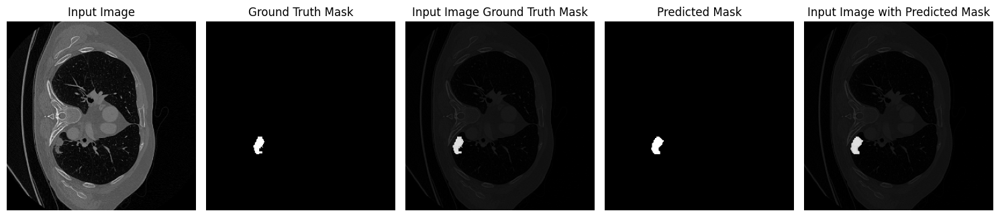

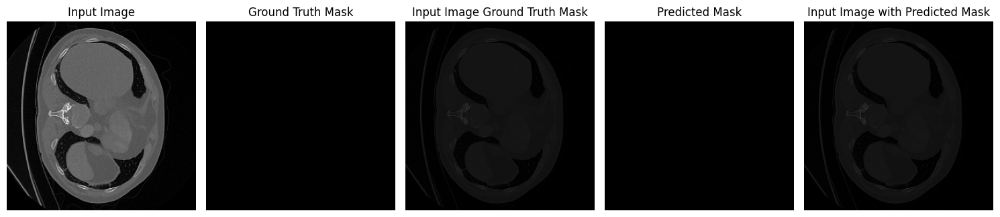

Epoch 98| Train_loss: 0.0973| Validate_loss: 0.2690| Val IOU: 0.5836| Val Best IOU 0.6289| Val Dice Coefficient 0.7357| lr 0.0001| Accuracy 0.9992


Epoch 99/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


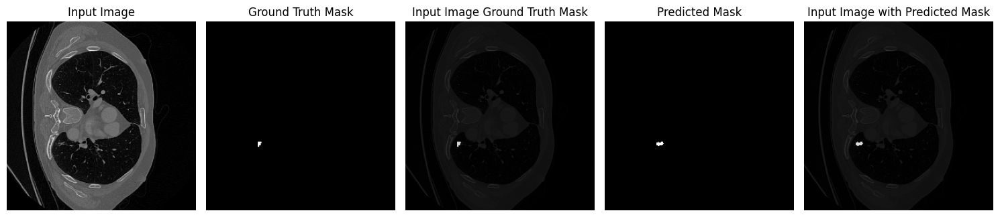

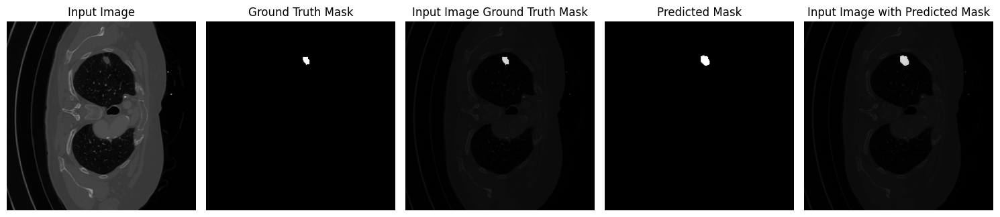

Epoch 99| Train_loss: 0.0998| Validate_loss: 0.2492| Val IOU: 0.6101| Val Best IOU 0.6289| Val Dice Coefficient 0.7552| lr 0.0001| Accuracy 0.9992


Epoch 100/100: 100%|██████████| 58/58 [00:21<00:00,  2.64it/s]


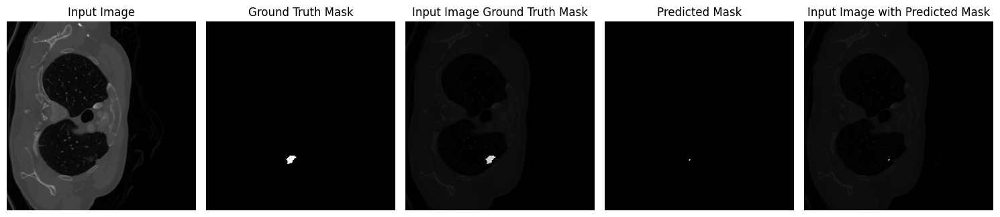

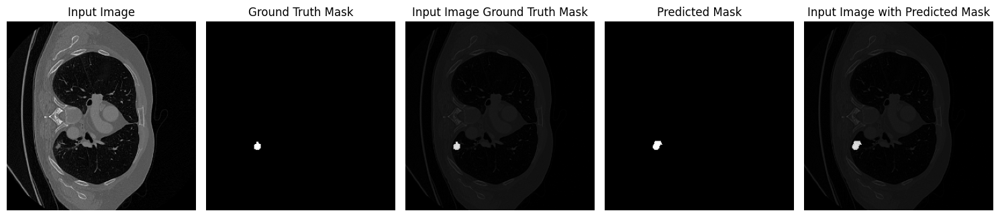

Epoch 100| Train_loss: 0.0984| Validate_loss: 0.2965| Val IOU: 0.5490| Val Best IOU 0.6289| Val Dice Coefficient 0.7076| lr 0.0001| Accuracy 0.9993


In [29]:
total_train_loss = []
total_val_loss = []
best_iou = 0

for epoch in range(EPOCHS):    
    model.train()
    epoch_loss = 0
    for img , mask in tqdm(train_loader,desc=f'Epoch {epoch+1}/{EPOCHS}'):
        
        optimizer.zero_grad()
        img , mask = img.to(device) , mask.to(device)
        
        pred = model(img)
        
        loss = loss_fn(pred,mask)
        
        loss.backward()
        
        norm = nn.utils.clip_grad_norm_(model.parameters(),1.0)
        
        optimizer.step()
        
        epoch_loss += loss.item()
    
    epoch_loss/=len(train_loader)
    val_loss,iou,dice,acc = validate(model,loss_fn,val_loader,device)
    
    scheduler.step(iou)
    current_lr = optimizer.param_groups[0]['lr']
    
    if iou > best_iou:
        print(f'Achieved Better IOU with {iou}, Than {best_iou}')
        best_iou = iou
        torch.save(model.state_dict(), os.path.join(model_dir,"UNet_weights.pth"))
        
    total_train_loss.append(epoch_loss)
    total_val_loss.append(val_loss)
    
    print(f"Epoch {epoch+1}| Train_loss: {epoch_loss:.4f}| Validate_loss: {val_loss:.4f}| Val IOU: {iou:.4f}| Val Best IOU {best_iou:.4f}| Val Dice Coefficient {dice:.4f}| lr {current_lr}| Accuracy {acc:.4f}")
    with open(log_file,'a') as f:
            f.write(f"Epoch {epoch+1}| Train_loss: {epoch_loss:.4f}| Validate_loss: {val_loss:.4f}| Val IOU: {iou:.4f}| Val Best IOU {best_iou:.4f}| Val Dice Coefficient {dice:.4f}| lr {current_lr:.4f}| Accuracy {acc:.4f}\n")  

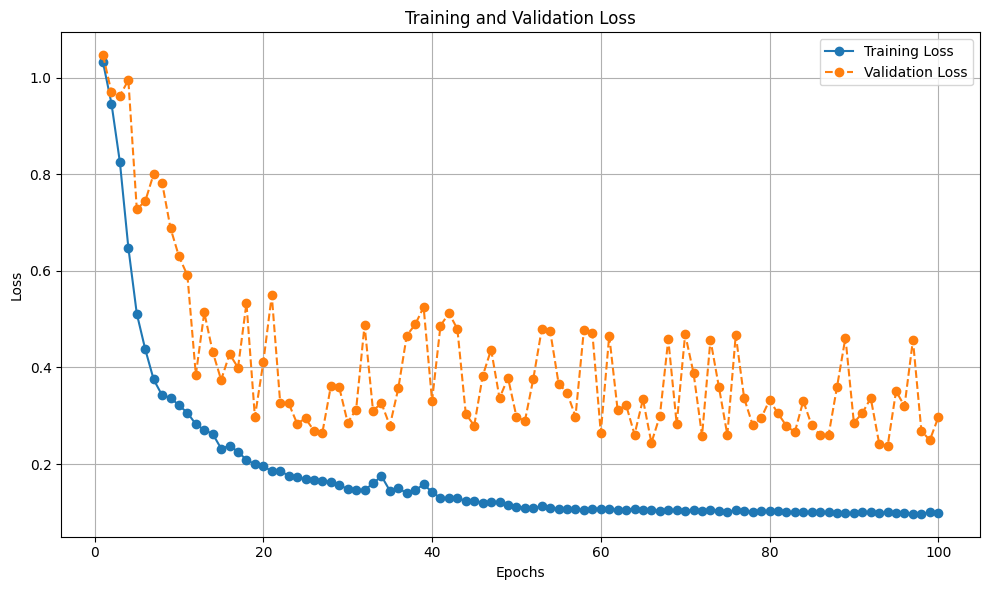

In [30]:
plt.figure(figsize=(10, 6))
epochs = range(1, len(total_train_loss) + 1)

# Plot training and validation loss
plt.plot(epochs, total_train_loss, label='Training Loss', marker='o', linestyle='-')
plt.plot(epochs, total_val_loss, label='Validation Loss', marker='o', linestyle='--')

# Add titles and labels
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid()

plt.savefig("loss_plot.png")

# Show the plot
plt.tight_layout()
plt.show()